# Exploratory Data Analysis

### 1.Data Preparation

In [ ]:
!pip install pydicom

     |████████████████████████████████| 1.9MB 7.1MB/s 


In [ ]:
import glob, pylab, pandas as pd
import pydicom, numpy as np
import random
import matplotlib.pyplot as plt
import seaborn as sns
import multiprocessing
from matplotlib.patches import Rectangle
from imgaug import augmenters as iaa
from sklearn.model_selection import KFold
from tqdm import tqdm
import os
import sys
import json
import math
import cv2
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
PATH="/content/drive/My Drive/Colab Notebooks/capstone/rsna-pneumonia-detection-challenge"
print(os.listdir(PATH))

['classifier_weights.hdf5', 'chexnet_model.hdf5', 'yolov3_chex_train_30.tf.data-00000-of-00001', 'yolov3_chexnet_model.hdf5', 'stage_2_detailed_class_info.csv', 'GCP Credits Request Link - RSNA.txt', 'stage_2_sample_submission.csv', 'stage_2_train_labels.csv', 'stage_2_test_images', 'stage_2_train_images', 'train_class_df.csv', 'test_class_df (1).csv', 'test_class_df.csv', 'model_weights.h5', 'model.h5', 'brucechou1983_CheXNet_Keras_0.3.0_weights.h5', 'densenet121_weights_tf_dim_ordering_tf_kernels_notop.h5', 'vgg19_weights_tf_dim_ordering_tf_kernels_notop.h5', 'my_model_weights.h5', 'my_model.h5', 'model_vgg_weights.h5', 'model_vgg.h5', 'model_resnet.h5', 'VGG19_&_ResNet_Implementation.ipynb', 'model_resnet_weights.h5', 'model_resnet_weights_new.h5', 'resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5', 'resnet50_csv_10.h5', 'RetinaNet.ipynb', 'train_data.csv', 'train.txt', 'JPEG', '.ipynb_checkpoints', 'train_jpg_images', 'pneumonia20201118T1224', 'train_dirs_label.csv', 'train_lab

In [ ]:
train_data = pd.read_csv(PATH+'/stage_2_train_labels.csv')
train_data.shape

(30227, 6)

In [ ]:
train_data.head(10)

,patientId,x,y,width,height,Target
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1
5,00436515-870c-4b36-a041-de91049b9ab4,562.0,152.0,256.0,453.0,1
6,00569f44-917d-4c86-a842-81832af98c30,NaN,NaN,NaN,NaN,0
7,006cec2e-6ce2-4549-bffa-eadfcd1e9970,NaN,NaN,NaN,NaN,0
8,00704310-78a8-4b38-8475-49f4573b2dbb,323.0,577.0,160.0,104.0,1
9,00704310-78a8-4b38-8475-49f4573b2dbb,695.0,575.0,162.0,137.0,1


In [ ]:
class_info = pd.read_csv(PATH+'/stage_2_detailed_class_info.csv')
class_info.shape

(30227, 2)

In [ ]:
class_info.head(10)

,patientId,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,No Lung Opacity / Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,No Lung Opacity / Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,No Lung Opacity / Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,Lung Opacity
5,00436515-870c-4b36-a041-de91049b9ab4,Lung Opacity
6,00569f44-917d-4c86-a842-81832af98c30,No Lung Opacity / Not Normal
7,006cec2e-6ce2-4549-bffa-eadfcd1e9970,No Lung Opacity / Not Normal
8,00704310-78a8-4b38-8475-49f4573b2dbb,Lung Opacity
9,00704310-78a8-4b38-8475-49f4573b2dbb,Lung Opacity


In [ ]:
len(train_data.patientId.unique())

26684

In [ ]:
# calculating aspect_ratio & area
train_data['aspect_ratio'] = (train_data['width']/train_data['height'])
train_data['area'] = train_data['width'] * train_data['height']

In [ ]:
# function to get info from dicom file
def get_dicom_info(patientId, root_dir= PATH+'/stage_2_train_images'):
    fn = os.path.join(root_dir, f'{patientId}.dcm')
    dcm_data = pydicom.read_file(fn)
    return {'age': dcm_data.PatientAge, 
            'gender': dcm_data.PatientSex, 
            'id': os.path.basename(fn).split('.')[0]}

In [ ]:
# getting info from dicom file
#patient_ids = list(train_data.patientId.unique())
dicom_info=[]
for i in patient_ids:
    dicom_info.append(get_dicom_info(i))

dicom_info = pd.DataFrame(dicom_info)
dicom_info['gender'] = dicom_info['gender'].astype('category')
dicom_info['age'] = dicom_info['age'].astype(int)

In [ ]:
# merging label info with dicom info
#train_data = (train_data.merge(dicom_info, left_on='patientId', right_on='id', how='left')
        .drop(columns='id'))

In [ ]:
train_data= pd.read_csv(PATH+'/train_data.csv')
train_data.head()

,patientId,x,y,width,height,Target,aspect_ratio,area,age,gender
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0,NaN,NaN,51,F
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0,NaN,NaN,48,F
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0,NaN,NaN,19,M
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0,NaN,NaN,28,M
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1,0.562005,80727.0,32,F


In [ ]:
# saving whole data
#train_data.to_csv('train_data.csv',index=False)

In [ ]:
train_data.shape

(30227, 10)

In [ ]:
# reading class info
class_info = pd.read_csv(PATH+'/stage_2_detailed_class_info.csv')

In [ ]:
# utility functions 

def draw(data):
    """
    Method to draw single patient with bounding box(es) if present 

    """
    # --- Open DICOM file
    d = pydicom.read_file(data['dicom'])
    im = d.pixel_array

    # --- Convert from single-channel grayscale to 3-channel RGB
    im = np.stack([im] * 3, axis=2)

    # --- Add boxes with random color if present
    for box in data['boxes']:
        rgb = np.floor(np.random.rand(3) * 256).astype('int')
        im = overlay_box(im=im, box=box, rgb=rgb, stroke=6)

    pylab.imshow(im, cmap=pylab.cm.gist_gray)
    pylab.axis('off')

def overlay_box(im, box, rgb, stroke=1):
    """
    Method to overlay single box on image

    """
    # --- Convert coordinates to integers
    box = [int(b) for b in box]
    
    # --- Extract coordinates
    y1, x1, height, width = box
    y2 = y1 + height
    x2 = x1 + width

    im[y1:y1 + stroke, x1:x2] = rgb
    im[y2:y2 + stroke, x1:x2] = rgb
    im[y1:y2, x1:x1 + stroke] = rgb
    im[y1:y2, x2:x2 + stroke] = rgb

    return im

def parse_data(df):
    """
    Method to read a CSV file (Pandas dataframe) and parse the 
    data into the following nested dictionary:

      parsed = {
        
        'patientId-00': {
            'dicom': path/to/dicom/file,
            'label': either 0 or 1 for normal or pnuemonia, 
            'boxes': list of box(es)
        },
        'patientId-01': {
            'dicom': path/to/dicom/file,
            'label': either 0 or 1 for normal or pnuemonia, 
            'boxes': list of box(es)
        }, ...

      }

    """
    # --- Define lambda to extract coords in list [y, x, height, width]
    extract_box = lambda row: [row['y'], row['x'], row['height'], row['width']]

    parsed = {}
    for n, row in df.iterrows():
        # --- Initialize patient entry into parsed 
        pid = row['patientId']
        if pid not in parsed:
            parsed[pid] = {
                'dicom': PATH+'/stage_2_train_images/%s.dcm' % pid,
                'label': row['Target'],
                'boxes': []}

        # --- Add box if opacity is present
        if parsed[pid]['label'] == 1:
            parsed[pid]['boxes'].append(extract_box(row))

    return parsed
parsed = parse_data(train_data)
print(parsed['00436515-870c-4b36-a041-de91049b9ab4'])

{'dicom': '../content/drive/My Drive/Colab Notebooks/capstone/rsna-pneumonia-detection-challenge/stage_2_train_images/00436515-870c-4b36-a041-de91049b9ab4.dcm', 'label': 1, 'boxes': [[152.0, 264.0, 379.0, 213.0], [152.0, 562.0, 453.0, 256.0]]}


In [ ]:
len(parsed)

26684

In [ ]:
train_data['Target'].value_counts()

0    20672
1     9555
Name: Target, dtype: int64

In [ ]:
class_info['class'].value_counts()

No Lung Opacity / Not Normal    11821
Lung Opacity                     9555
Normal                           8851
Name: class, dtype: int64

In [ ]:
def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    return np.transpose(pd.concat([total, percent], axis=1, keys=['Total', 'Percent']))
missing_data(train_data)

,area,aspect_ratio,height,width,y,x,gender,age,Target,patientId
Total,20672.000000,20672.000000,20672.000000,20672.000000,20672.000000,20672.000000,0.0,0.0,0.0,0.0
Percent,68.389188,68.389188,68.389188,68.389188,68.389188,68.389188,0.0,0.0,0.0,0.0


### 2.Data Overview

#### 2.1 Sample DICOM file

In [ ]:
patientId = train_data['patientId'][0]
dcm_file = PATH+'/stage_2_train_images/%s.dcm' % patientId
dcm_data = pydicom.read_file(dcm_file)

print(dcm_data)

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 202
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: Secondary Capture Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.276.0.7230010.3.1.4.8323329.28530.1517874485.775526
(0002, 0010) Transfer Syntax UID                 UI: JPEG Baseline (Process 1)
(0002, 0012) Implementation Class UID            UI: 1.2.276.0.7230010.3.0.3.6.0
(0002, 0013) Implementation Version Name         SH: 'OFFIS_DCMTK_360'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0016) SOP Class UID                       UI: Secondary Capture Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.276.0.7230010.3.1.4.8323329.28530.1517874485.775526
(0008, 0020) Study Date                          DA: '19010101'
(0008, 0030) Study Time      

#### 2.2 Sample CXR image (without opacities)

(-0.5, 1023.5, 1023.5, -0.5)

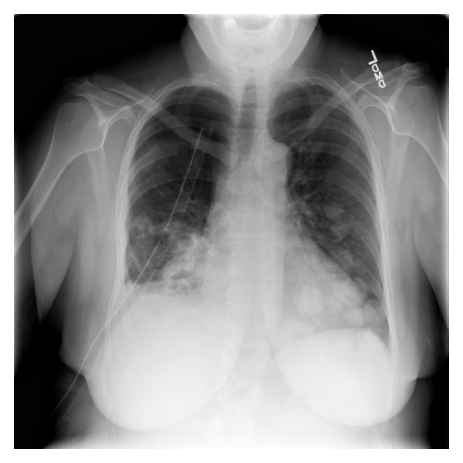

In [ ]:
# reading image array from DICOM file
im = dcm_data.pixel_array
pylab.imshow(im, cmap=pylab.cm.gist_gray)
pylab.axis('off')

#### 2.3 CXR image with bounding box around opacities

In [ ]:
def get_id(data,bbox=1):
    keys = data.keys()
    for i in keys:
        if len(data[i]['boxes']) == bbox:
            return i

In [ ]:
pd.DataFrame(parsed)

,0004cfab-14fd-4e49-80ba-63a80b6bddd6,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,00322d4d-1c29-4943-afc9-b6754be640eb,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,00436515-870c-4b36-a041-de91049b9ab4,00569f44-917d-4c86-a842-81832af98c30,006cec2e-6ce2-4549-bffa-eadfcd1e9970,00704310-78a8-4b38-8475-49f4573b2dbb,008c19e8-a820-403a-930a-bc74a4053664,009482dc-3db5-48d4-8580-5c89c4f01334,009eb222-eabc-4150-8121-d5a6d06b8ebf,00a85be6-6eb0-421d-8acf-ff2dc0007e8a,00aecb01-a116-45a2-956c-08d2fa55433f,00c0b293-48e7-4e16-ac76-9269ba535a62,00d7c36e-3cdf-4df6-ac03-6c30cdc8e85b,00f08de1-517e-4652-a04f-d1dc9ee48593,00f87de5-5fe0-4921-93ea-914d7e683266,0100515c-5204-4f31-98e0-f35e4b00004a,01027bc3-dc40-4165-a6c3-d6be2cb7ca34,010ccb9f-6d46-4380-af11-84f87397a1b8,011d6f51-b732-4d45-a84d-90477325ef2d,012a5620-d082-4bb8-9b3b-e72d8938000c,014b7b58-f641-4477-8bbc-ae6f337745d6,01538c3b-3de9-4fbb-95a8-732235821bbf,016b1f90-bb9a-4d3a-9c38-74af5fffd5b5,0174c4bb-28f5-41e3-a13f-a396badc18bd,017c7b5b-618e-4bc9-943c-04c6a988d992,019ca122-9cdf-4704-b7a9-449c8a1c263e,019d950b-dd38-4cf3-a686-527a75728be6,019e035e-2f82-4c66-a198-57422a27925f,01a4059c-22f7-4f51-8a27-50aff0b3aeb3,01a5594f-e5d4-4f7a-b79d-3f57559fe37b,01a6eaa6-222f-4ea8-9874-bbd89dc1a1ce,01a7353d-25bb-4ff8-916b-f50dd541dccf,01aad2a6-3b93-45e3-bf37-2d73348cb6fc,01adfd2f-7bc7-4cef-ab68-a0992752b620,01b15f07-1149-4ff8-9756-bc821e41b97c,01b56434-4dd9-4994-bcc5-0b70a36e415a,01b9e362-4950-40f5-88fa-7557ac2a45bb,01be392f-a46d-4aef-a57e-9cd1a80dd47e,...,c09b4889-d8d1-4690-806e-dfada1f79e0b,c0a4c55a-bd1b-4459-ba2a-8a687c2732e9,c0d8eb9f-8276-414b-8cbb-d8f28b61aac1,c0dd2290-7dc1-4589-8061-57dfdfa23a4c,c0dec778-b56c-4c6e-8132-a606e845235c,c0efaacc-6601-4193-9858-f5da77a86ee3,c0f3d102-ed5f-4820-81d4-89cefcf2d53a,c102bfc2-601d-4275-b986-d928bf170ef9,c104d585-85a7-4071-b7ff-930ac2565128,c1051685-99dc-41aa-be48-a3d120194035,c106ddba-42f7-440c-9ba9-f3fa6692f06f,c10726b6-c944-403f-9062-f0bf922ef149,c109061a-d815-4cae-8343-9230d8024adf,c1098ce4-cb15-41c6-ba39-1fa511b82100,c10ae3e5-822f-49e9-8c02-b0e2a98eddc1,c110e1ed-fb28-4b3d-b450-e370f13d4293,c1265ac3-6eae-4cf3-9880-26fd430312f3,c1273696-fdec-48a9-988c-74e57b6323fa,c12aafdd-4d21-4cd3-a2ae-007bce2e2fc0,c1415e26-fddf-4a0c-a7eb-7b9a0d9e9983,c145df8e-9631-468d-af7f-5690c11c2c88,c14d9ceb-019f-45f6-9299-281b58de57df,c1592aae-c80d-4794-ab28-463905558534,c1628c47-5ba3-42dd-8df3-7ad3abd57ad0,c164b17b-aff8-484f-9d9e-dde2932d8df9,c1718678-44af-407f-829a-fc65bc854094,c18d1138-ba74-4af5-af21-bdd4d2c96bb5,c196ce23-f37c-4ab3-a9ce-ea8ede90e09c,c19b8a3b-ab4e-4a73-8e13-ec0a84b6b6c7,c1c3ec5d-20ba-42f7-91f9-48032d97ffc9,c1ca4417-83a6-43a7-a9bf-7d9587e7f14f,c1cddf32-b957-4753-acaa-472ab1447e86,c1cf3255-d734-4980-bfe0-967902ad7ed9,c1e228e4-b7b4-432b-a735-36c48fdb806f,c1e3eb82-c55a-471f-a57f-fe1a823469da,c1e73a4e-7afe-4ec5-8af6-ce8315d7a2f2,c1ec14ff-f6d7-4b38-b0cb-fe07041cbdc8,c1edf42b-5958-47ff-a1e7-4f23d99583ba,c1f6b555-2eb1-4231-98f6-50a963976431,c1f7889a-9ea9-4acb-b64c-b737c929599a
dicom,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Colab Notebooks/caps...,../content/drive/My Drive/Col

* **Image with 1 bounding box**

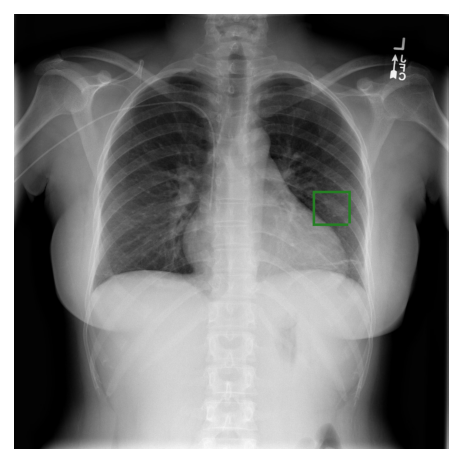

In [ ]:
im = draw(parsed[get_id(parsed,bbox=1)])
plt.grid(False)


* **Image with 2 bounding boxes**

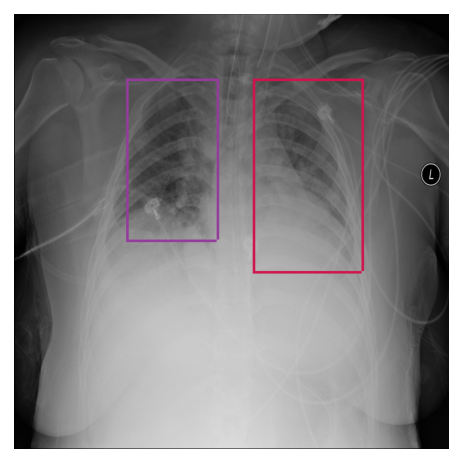

In [ ]:
im = draw(parsed[get_id(parsed,bbox=2)])
plt.grid(False)


* **Image with 3 bounding boxes**

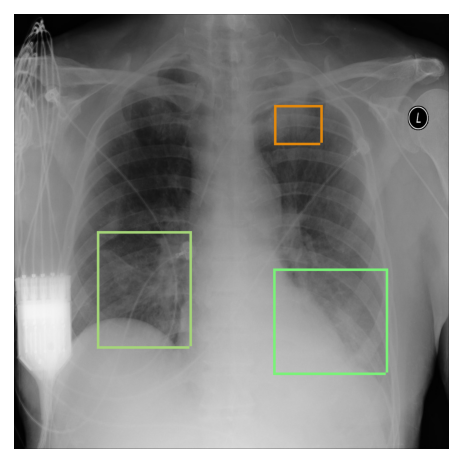

In [ ]:
im = draw(parsed[get_id(parsed,bbox=3)])
plt.grid(False)


* **Image with 4 bounding boxes**

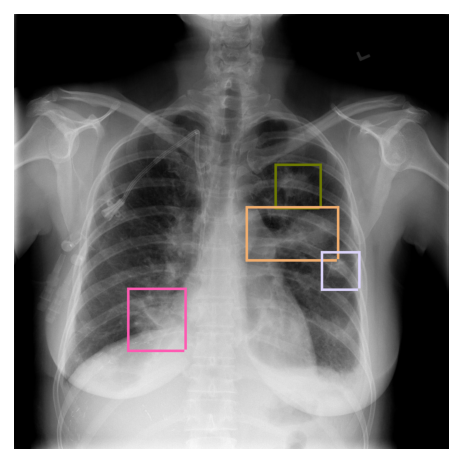

In [ ]:
im = draw(parsed[get_id(parsed,bbox=4)])
plt.grid(False)

**Observation:-**
1. The minimum number of opacities is 1.
2. the maximum number of opacities is 4.

In [ ]:
detailed_data = pd.concat([train_data, class_info], join='inner', axis=1)
detailed_data.drop(detailed_data.columns[[10]], axis=1, inplace=True)

In [ ]:
detailed_data['patientId'] = train_data['patientId']
detailed_data.head()

,x,y,width,height,Target,aspect_ratio,area,age,gender,class,patientId
0,NaN,NaN,NaN,NaN,0,NaN,NaN,51,F,No Lung Opacity / Not Normal,0004cfab-14fd-4e49-80ba-63a80b6bddd6
1,NaN,NaN,NaN,NaN,0,NaN,NaN,48,F,No Lung Opacity / Not Normal,00313ee0-9eaa-42f4-b0ab-c148ed3241cd
2,NaN,NaN,NaN,NaN,0,NaN,NaN,19,M,No Lung Opacity / Not Normal,00322d4d-1c29-4943-afc9-b6754be640eb
3,NaN,NaN,NaN,NaN,0,NaN,NaN,28,M,Normal,003d8fa0-6bf1-40ed-b54c-ac657f8495c5
4,264.0,152.0,213.0,379.0,1,0.562005,80727.0,32,F,Lung Opacity,00436515-870c-4b36-a041-de91049b9ab4


In [ ]:
samplePatientID = list(detailed_data[:3].T.to_dict().values())[0]['patientId']
samplePatientID = samplePatientID+'.dcm'
dicom_file_path = os.path.join(PATH,"stage_2_train_images/",samplePatientID)

In [ ]:
def get_boxes_per_patient(df, pId):
    '''
    Given the dataset and one patient ID, 
    return an array of all the bounding boxes and their labels associated with that patient ID.
    Example of return: 
    array([[x1, y1, width1, height1, class1, target1],
           [x2, y2, width2, height2, class2, target2]])
    '''
    
    boxes = df.loc[df['patientId']==pId][['x', 'y', 'width', 'height', 'class', 'Target']].values
    return boxes

def get_dcm_data_per_patient(pId, sample='train'):
    '''
    Given one patient ID and the sample name (train/test), 
    return the corresponding dicom data.
    '''
    return pydicom.read_file(dicom_file_path)

def display_image_per_patient(df, pId, angle=0.0, sample='train'):
    '''
    Given one patient ID and the dataset,
    display the corresponding dicom image with overlaying boxes and class annotation.
    To be implemented: Optionally input the image rotation angle, in case of data augmentation.
    '''
    dcmdata = get_dcm_data_per_patient(pId, sample=sample)
    dcmimg = dcmdata.pixel_array
    boxes = get_boxes_per_patient(df, pId)
    plt.figure(figsize=(20,10))
    plt.imshow(dcmimg, cmap=pylab.cm.binary)
    plt.axis('off')
    
    class_color_dict = {'Normal' : 'green',
                        'No Lung Opacity / Not Normal' : 'orange',
                        'Lung Opacity' : 'red'}

    if len(boxes)>0:
        for box in boxes:
            # extracting individual coordinates and labels
            x, y, w, h, c, t = box 
            # create a rectangle patch
            patch = Rectangle((x,y), w, h, color='red', 
                              angle=angle, fill=False, lw=4, joinstyle='round', alpha=0.6)
            # get current axis and draw rectangle
            plt.gca().add_patch(patch)
            
    # add annotation text
    plt.text(10, 50, c, color=class_color_dict[c], size=20, 
             bbox=dict(edgecolor=class_color_dict[c], facecolor='none', alpha=0.5, lw=2))

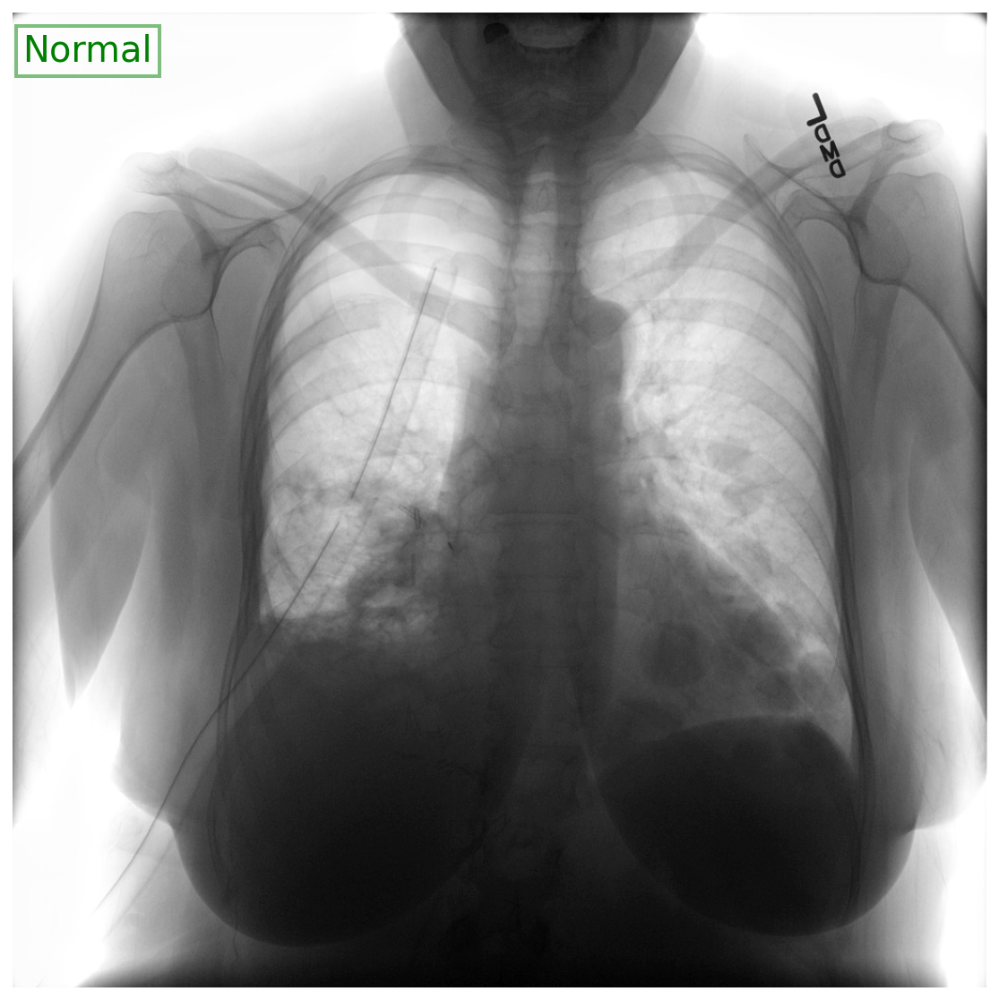

In [ ]:
pId = detailed_data['patientId'].sample(1).values[0]    
display_image_per_patient(detailed_data, pId, sample='train')

In [ ]:
## Plot DICOM images with Target = 1

def show_dicom_images(data):
    img_data = list(data.T.to_dict().values())
    f, ax = plt.subplots(3,3, figsize=(16,18))
    for i,data_row in enumerate(img_data):
        patientImage = data_row['patientId']+'.dcm'
        imagePath = os.path.join(PATH,"stage_2_train_images/",patientImage)
        data_row_img_data = pydicom.read_file(imagePath)
        modality = data_row_img_data.Modality
        age = data_row_img_data.PatientAge
        sex = data_row_img_data.PatientSex
        data_row_img = pydicom.dcmread(imagePath)
        ax[i//3, i%3].imshow(data_row_img.pixel_array, cmap=plt.cm.bone) 
        ax[i//3, i%3].axis('off')
        ax[i//3, i%3].set_title('ID: {}\nModality: {} Age: {} Sex: {} Target: {}\nClass: {}\nWindow: {}:{}:{}:{}'.format(
                data_row['patientId'],
                modality, age, sex, data_row['Target'], data_row['class'], 
                data_row['x'],data_row['y'],data_row['width'],data_row['height']))
    plt.show()

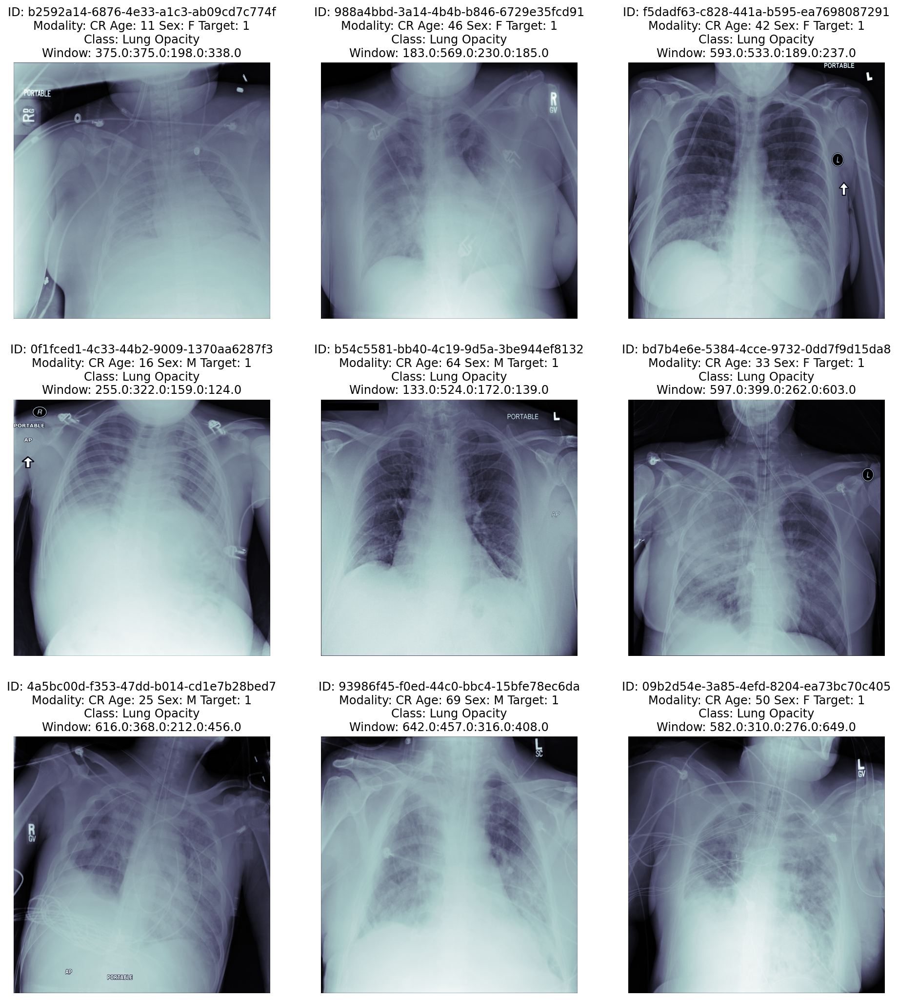

In [ ]:
show_dicom_images(detailed_data[detailed_data['Target']==1].sample(9))

In [ ]:
 ## represent the images with the overlay boxes superposed. For this, we will need first to parse the whole dataset with Target = 1  the windows showing a Lung Opacity on the same image

 def show_dicom_images_with_boxes(data):
    img_data = list(data.T.to_dict().values())
    f, ax = plt.subplots(3,3, figsize=(16,18))
    for i,data_row in enumerate(img_data):
        patientImage = data_row['patientId']+'.dcm'
        imagePath = os.path.join(PATH,"stage_2_train_images/",patientImage)
        data_row_img_data = pydicom.read_file(imagePath)
        modality = data_row_img_data.Modality
        age = data_row_img_data.PatientAge
        sex = data_row_img_data.PatientSex
        data_row_img = pydicom.dcmread(imagePath)
        ax[i//3, i%3].imshow(data_row_img.pixel_array, cmap=plt.cm.bone) 
        ax[i//3, i%3].axis('off')
        ax[i//3, i%3].set_title('ID: {}\nModality: {} Age: {} Sex: {} Target: {}\nClass: {}'.format(
                data_row['patientId'],modality, age, sex, data_row['Target'], data_row['class']))
        rows = detailed_data[detailed_data['patientId']==data_row['patientId']]
        box_data = list(rows.T.to_dict().values())
        for j, row in enumerate(box_data):
            ax[i//3, i%3].add_patch(Rectangle(xy=(row['x'], row['y']),
                        width=row['width'],height=row['height'], 
                        color="yellow",alpha = 0.1))   
    plt.show()

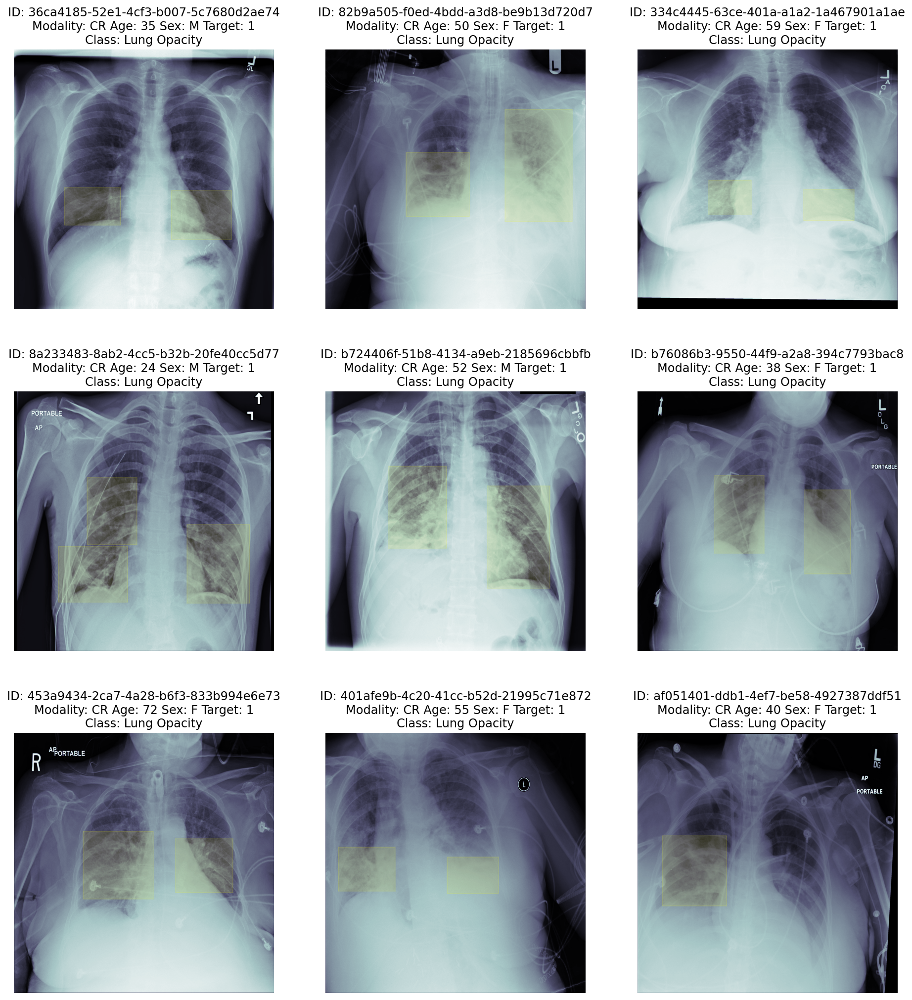

In [ ]:
show_dicom_images_with_boxes(detailed_data[detailed_data['Target']==1].sample(9))

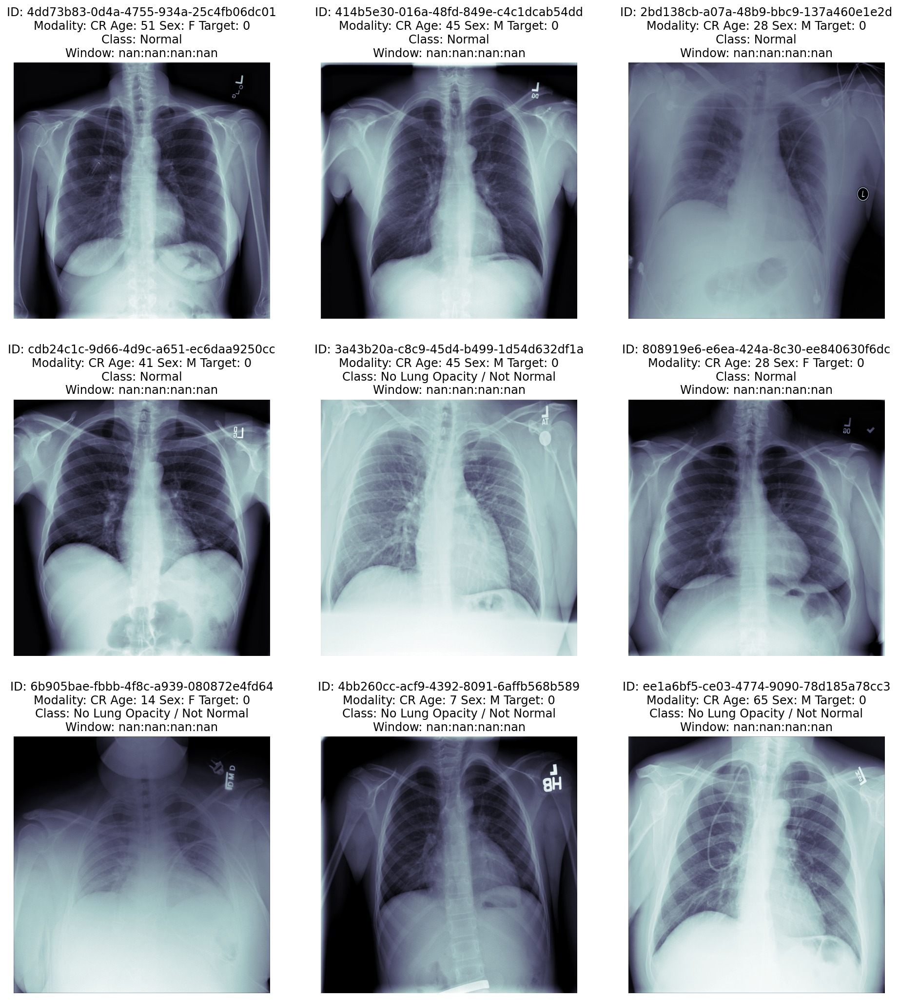

In [ ]:
show_dicom_images(detailed_data[detailed_data['Target']==0].sample(9))

### 3.Univariate Analysis

#### 3.1 Class Imbalance

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


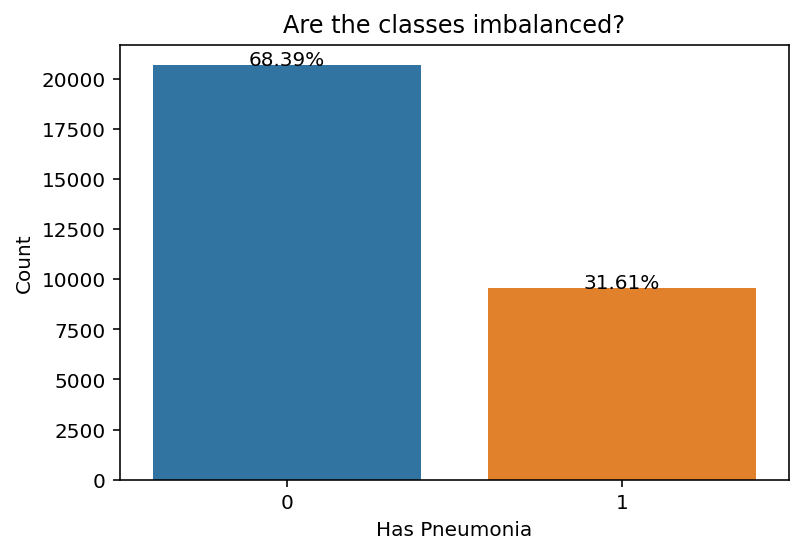

In [ ]:
f, ax = plt.subplots(1,1, figsize=(6,4))
total = float(len(train_data))
sns.countplot(train_data['Target'],order = train_data['Target'].value_counts().index)
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}%'.format(100*height/total),
            ha="center") 

ax.set_title('Are the classes imbalanced?')
ax.set_xlabel('Has Pneumonia')
ax.set_ylabel('Count')
ax.xaxis.set_tick_params(rotation=0)
plt.show()

**Observation:-**
1. From the plot,it is clear that the data is highly imbalanced.
2. There is almost 5000 positive & 20000 negative points.
3. The imbalance ratio is almost 4:1 (negative:positive)
4. The reason behind the imbalance is that there are almost 11000 datapoints which are classified as No Lung Opacity / Not Normal, but those points are also considered as negative.

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


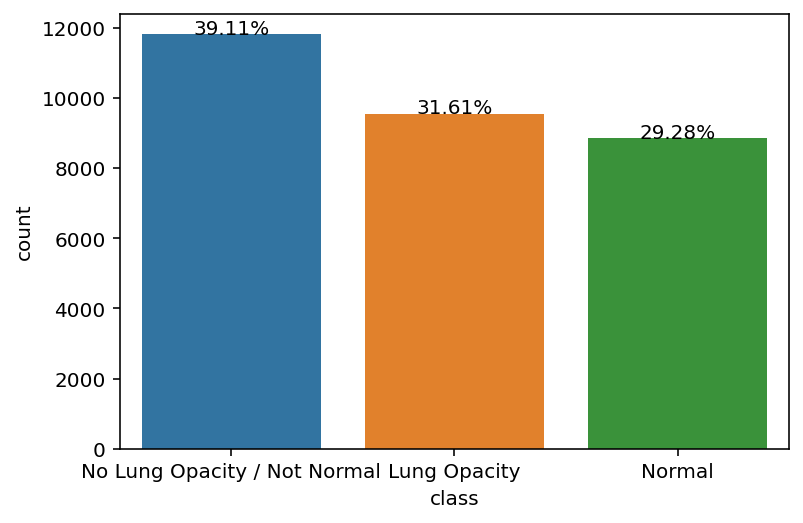

In [ ]:
f, ax = plt.subplots(1,1, figsize=(6,4))
total = float(len(class_info))
sns.countplot(class_info['class'],order = class_info['class'].value_counts().index)
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}%'.format(100*height/total),
            ha="center") 
plt.show()

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


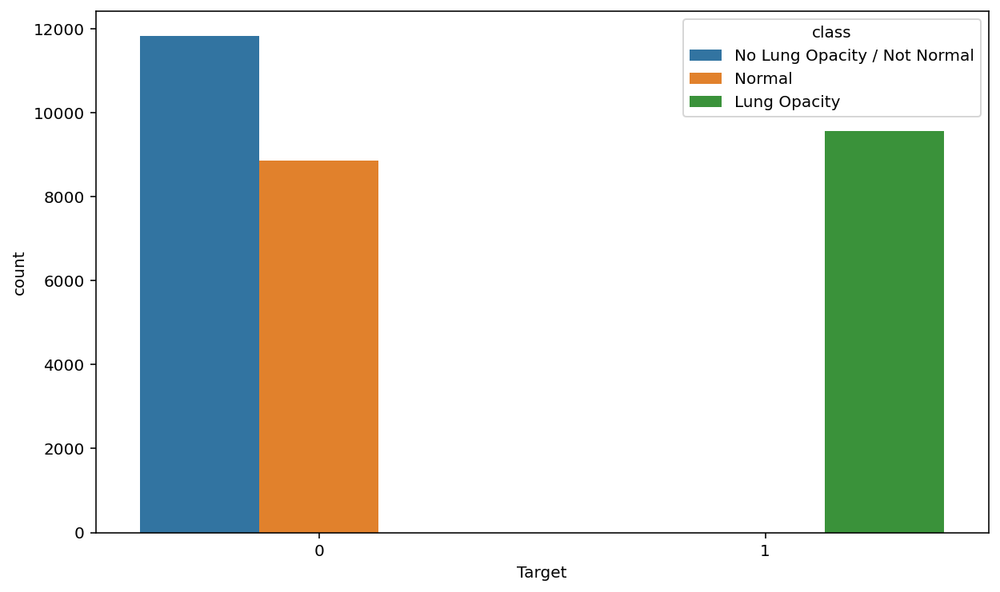

In [ ]:
plt.figure(figsize=(10,6))
sns.countplot(detailed_data['Target'], hue=detailed_data['class'])

#### 3.2 Bounding Box X-Coordinates 

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

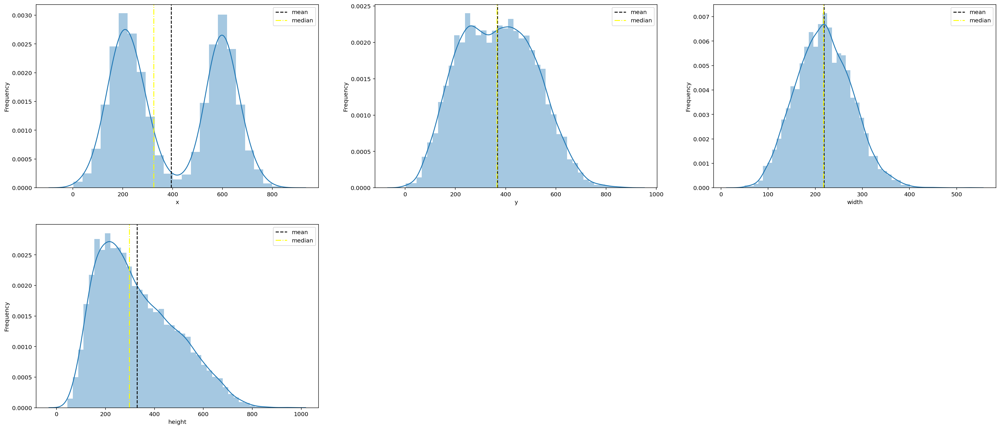

In [ ]:
col = ['x', 'y', 'width', 'height']
plt.figure(figsize=(30,20))

n=1
for i in col:
  plt.subplot(3,3,n)
  sns.distplot(train_data[train_data['Target']==1][i], kde=True)
  plt.axvline(train_data[train_data['Target']==1][i].mean(), linestyle="dashed", label="mean", color='black')
  plt.axvline(train_data[train_data['Target']==1][i].median(), linestyle="dashdot", label="median", color='yellow')
  plt.ylabel("Frequency")
  plt.legend()
  n += 1

In [ ]:
# function to plot PDF
def plot_pdf(data,x_label,y_label,title):
    f,ax = plt.subplots(1,1, figsize=(7.5,4))
    sns.distplot(a=data, ax=ax)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)
    plt.show()

# function to plot CDF
def plot_cdf(data,x_label,y_label,title):
    f,ax = plt.subplots(1,1, figsize=(7.5,4))
    counts, bin_edges = np.histogram(data.dropna(), bins=10, 
                                     density = True)
    pdf = counts/(sum(counts))#cal pdf
    cdf = np.cumsum(pdf)#cumulative sum of pdf,calculating cdf
    plt.plot(bin_edges[1:], cdf)
    plt.ylabel(y_label)
    plt.xlabel(x_label)
    plt.title(title)
    plt.show()
# function to plot box_plot    
def box_plot(data,col,title):
    f,ax = plt.subplots(1,1, figsize=(7.5,4))
    sns.boxplot(y=col, data=data,ax=ax)
    plt.title(title)
    plt.show()

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


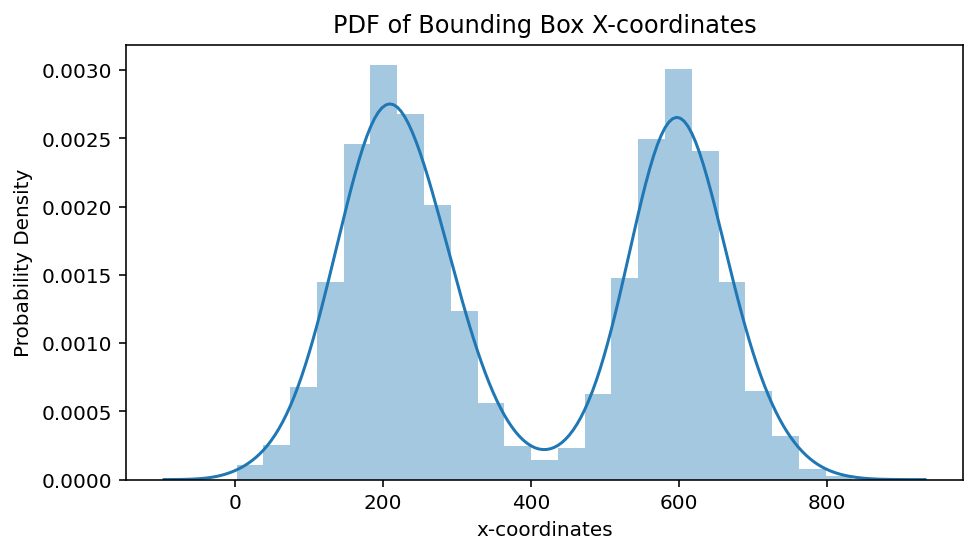

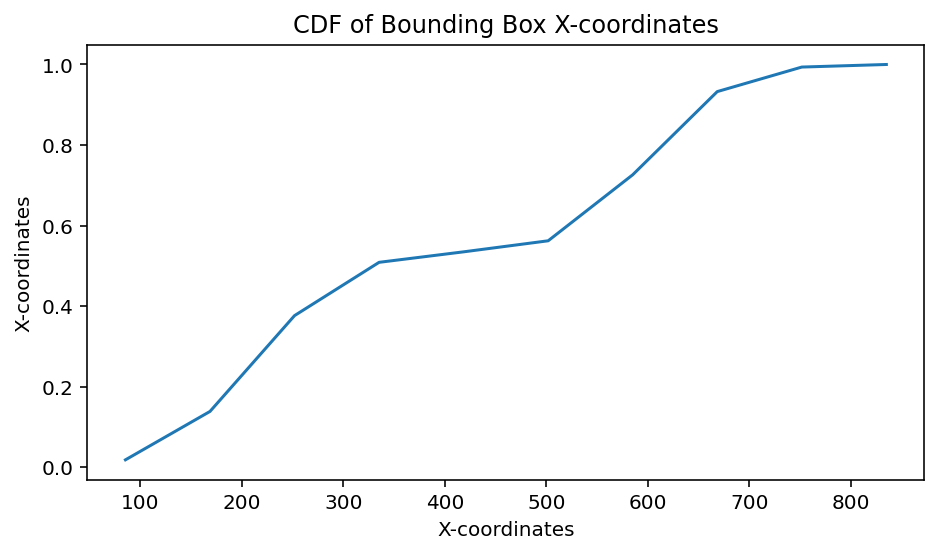

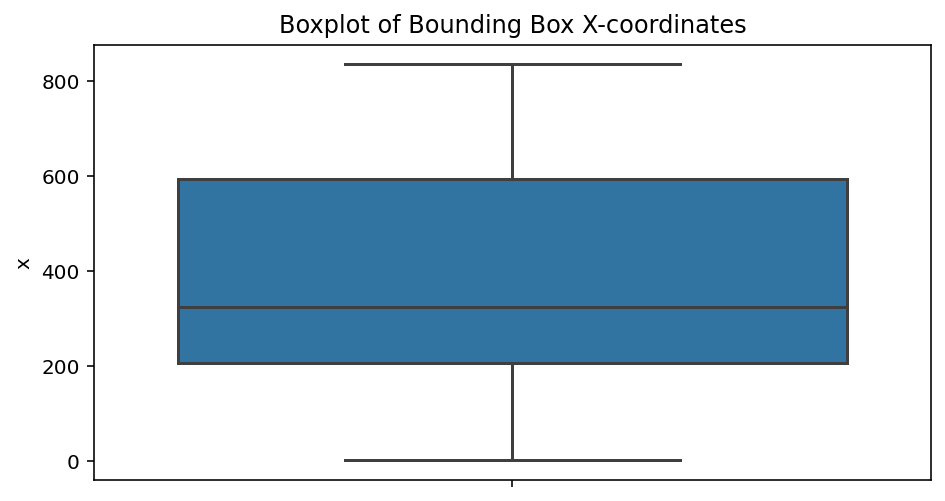

In [ ]:
plot_pdf(train_data.x.values,'x-coordinates','Probability Density','PDF of Bounding Box X-coordinates')
plot_cdf(train_data['x'],'X-coordinates','X-coordinates','CDF of Bounding Box X-coordinates')
box_plot(train_data,'x','Boxplot of Bounding Box X-coordinates')

>**Observation:-**
1. The double-bell curve that we got in PDF of x-coordinates is due to the location of the lungs (as the opacity bounding boxes are on lungs only).
2. The x-coordinates passing over the lungs has high values in comparison to the area which do not have lungs.
3. The range that we got for x-coordinates is from 0 to 800.
4. Almost 99% of the x-coordinate values are less that 750.
5. The IQR(interquartile range) that we got is from 200 (25th percentile) & 600(75th percentile).
6. The median value that we got is 300(approx)

#### 3.3 Bounding Box y-Coordinates 

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


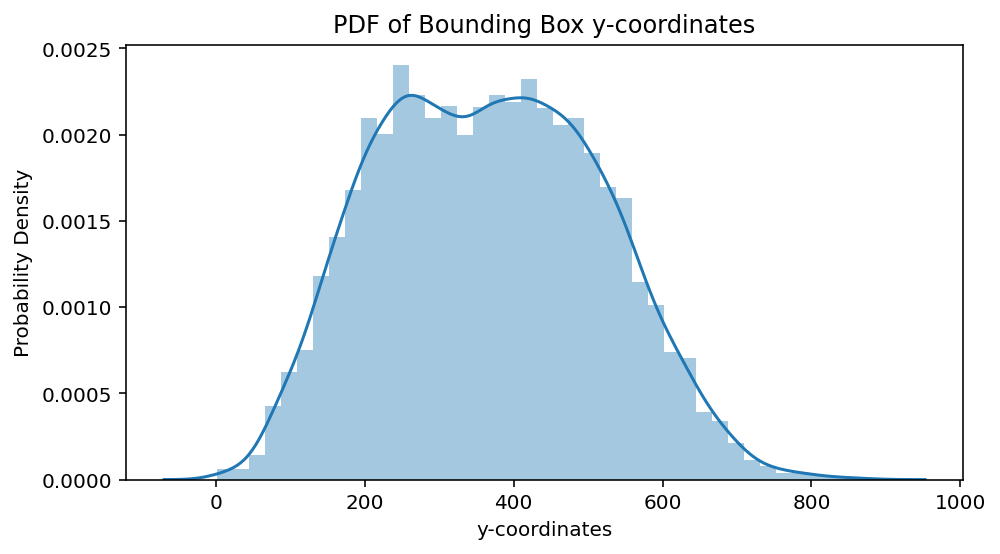

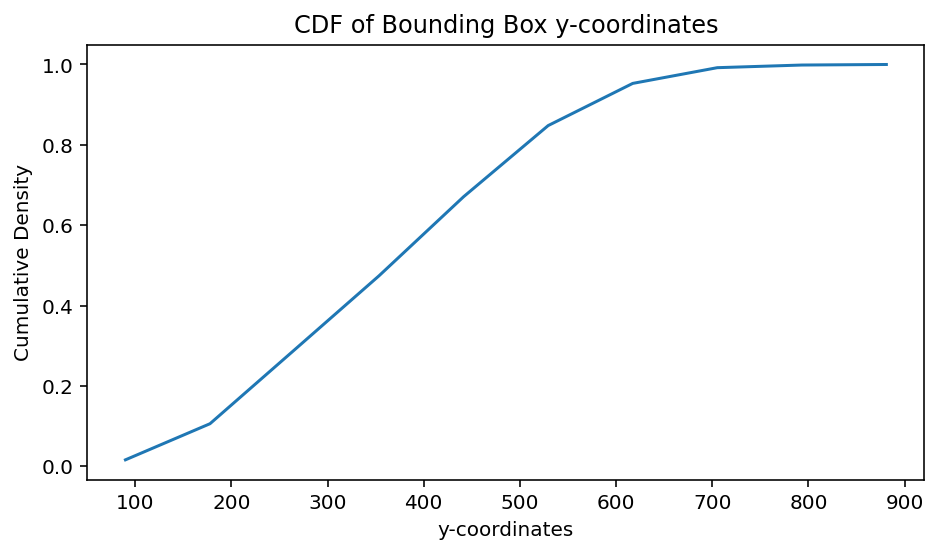

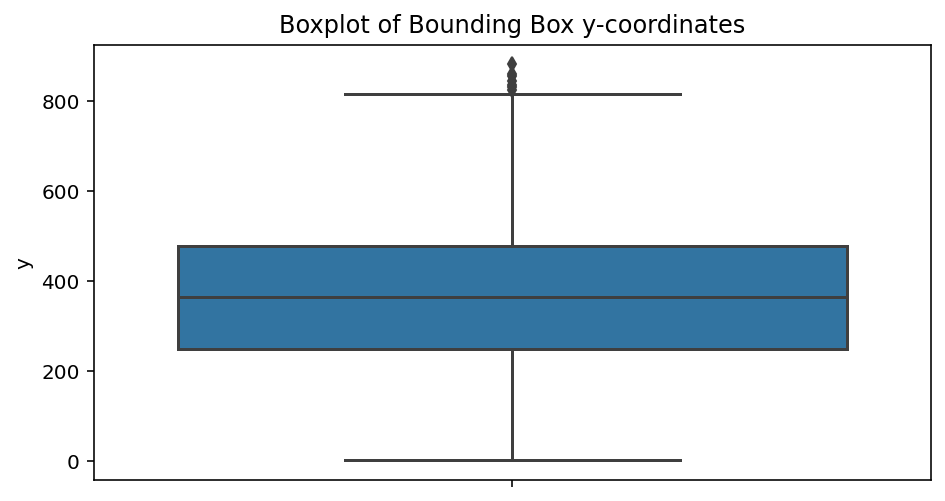

In [ ]:
plot_pdf(train_data.y.values,'y-coordinates','Probability Density','PDF of Bounding Box y-coordinates')
plot_cdf(train_data['y'],'y-coordinates','Cumulative Density','CDF of Bounding Box y-coordinates')
box_plot(train_data,'y','Boxplot of Bounding Box y-coordinates')

>**Observation:-**
1. The decline that we can observe at the middle of the curve is due to the centre of the chest as there is no lungs at the centre (and bounding boxes are only on lungs).
2. The minimum & maximum value that we got is 0 and 800 respectively.
3. Almost 99% values are between 100 & 700.
4. The IQR(inerquartile range) we got is from 250 (25th percentile) & 500 (75th percentile).
5. The median value that we got is 350 (approx).
6. There are certain outlier values also above 800.

#### 3.4 Bounding Box width

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


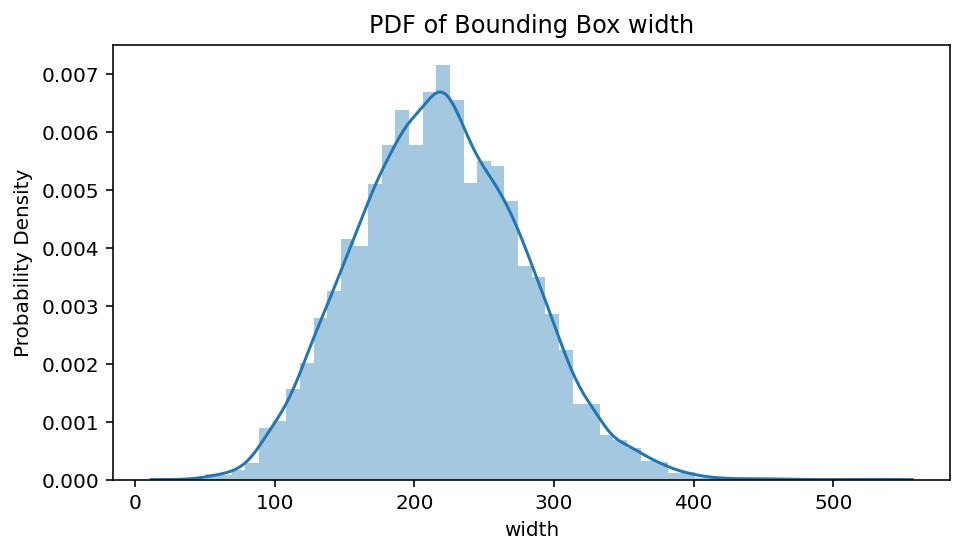

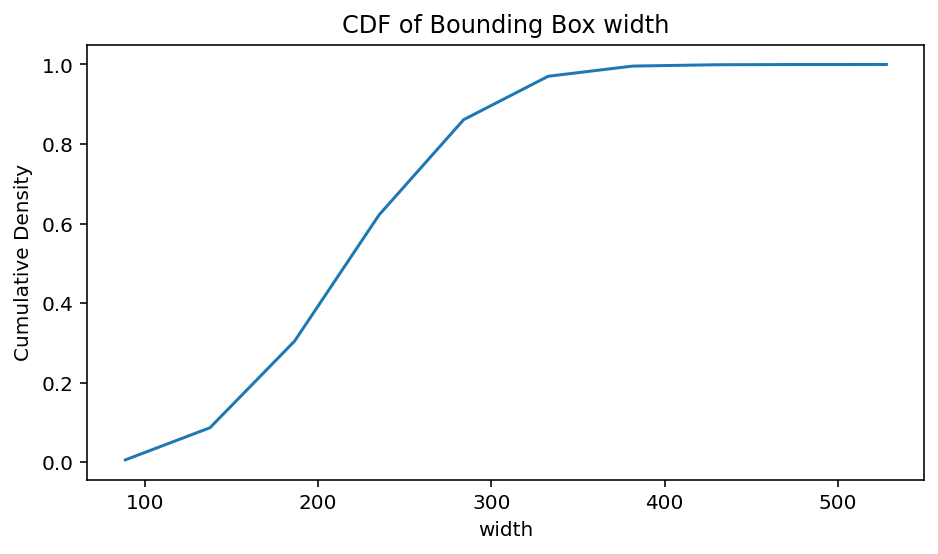

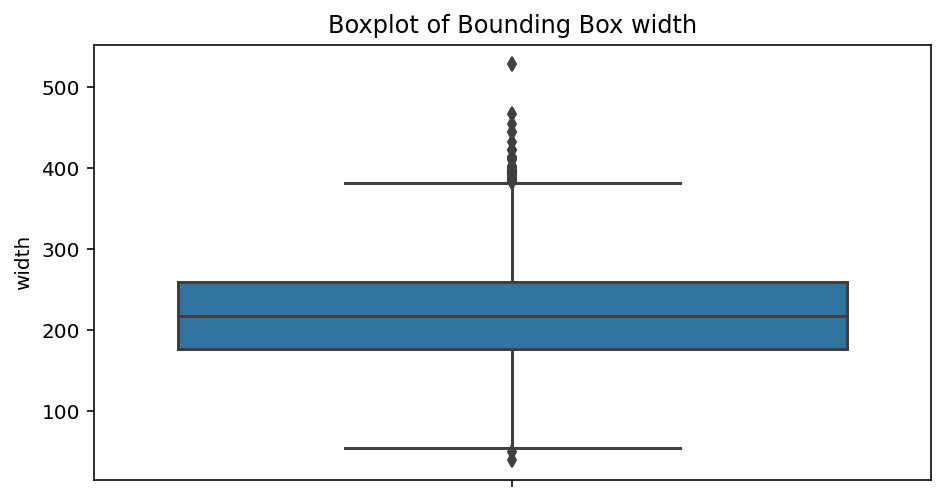

In [ ]:
plot_pdf(train_data.width.values,'width','Probability Density','PDF of Bounding Box width')
plot_cdf(train_data['width'],'width','Cumulative Density','CDF of Bounding Box width')
box_plot(train_data,'width','Boxplot of Bounding Box width')

>**Observation:-**
1. The PDF of the bounding box width that we got is approx normally distributed.
2. The minimum & maximum values that we got is 50 & 400 with certain outliers above 400.
3. Almost 99% values are less than 350.
4. The IQR(interquartile range) that we got is from 175 to 275 respectively.
5. The median value that we got is 225 (approx).

#### 3.5 Bounding Box Height

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


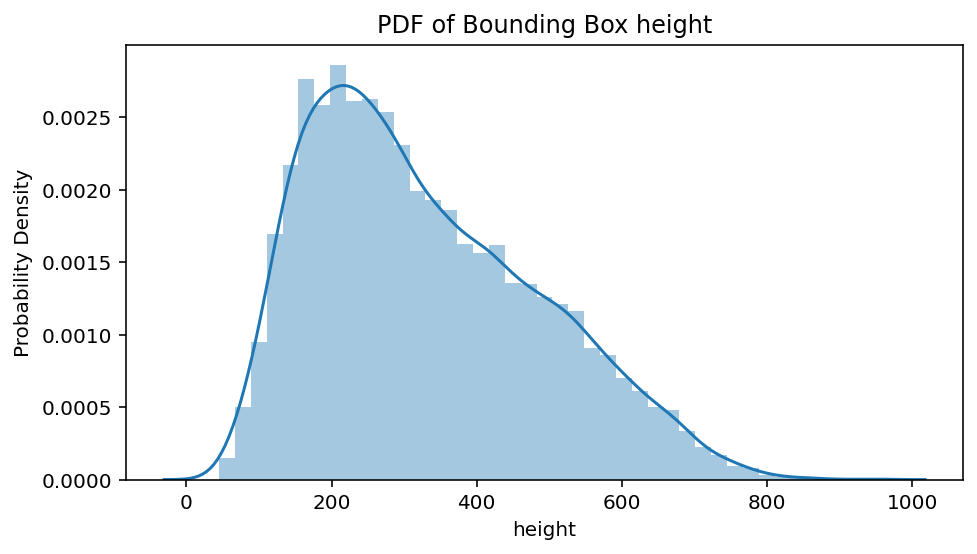

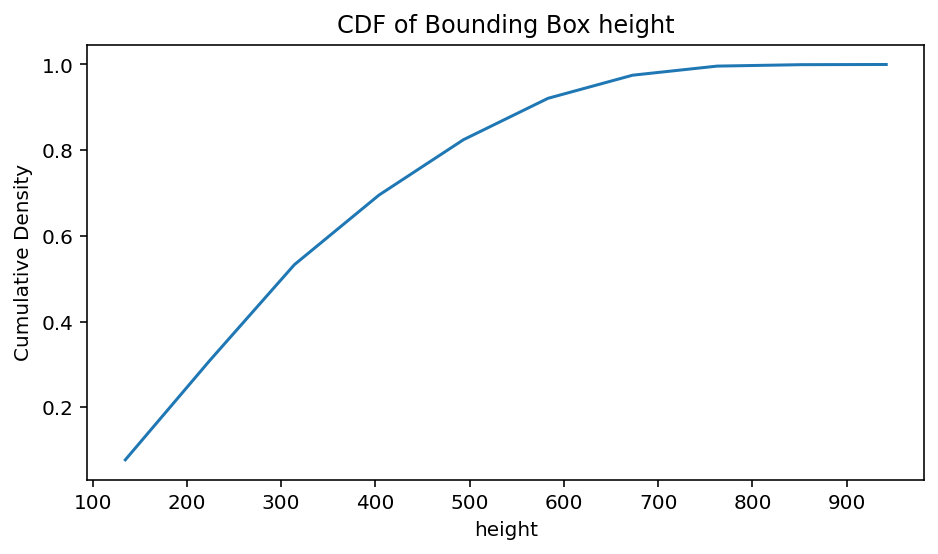

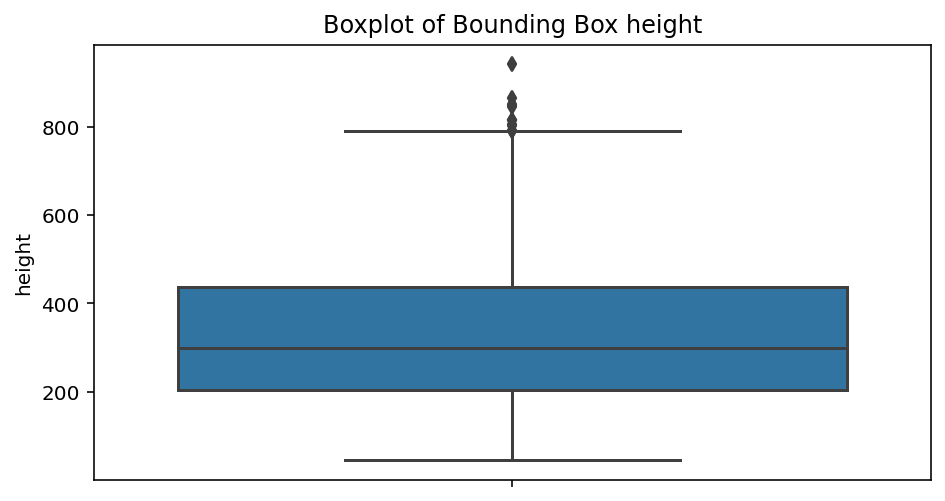

In [ ]:
plot_pdf(train_data.height.values,'height','Probability Density','PDF of Bounding Box height')
plot_cdf(train_data['height'],'height','Cumulative Density','CDF of Bounding Box height')
box_plot(train_data,'height','Boxplot of Bounding Box height')

>**Observation:-**
1. The PDF of the bounding box height that we got is positively skewed.
2. The minimum & maximum values that we got is 0 & 800 with certain outliers above 800.
3. Almost 99% values are less than 700.
4. The IQR(interquartile range) that we got is from 200 to 450 respectively.
5. The median value that we got is 300 (approx).

#### 3.6 Bounding Box Area

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


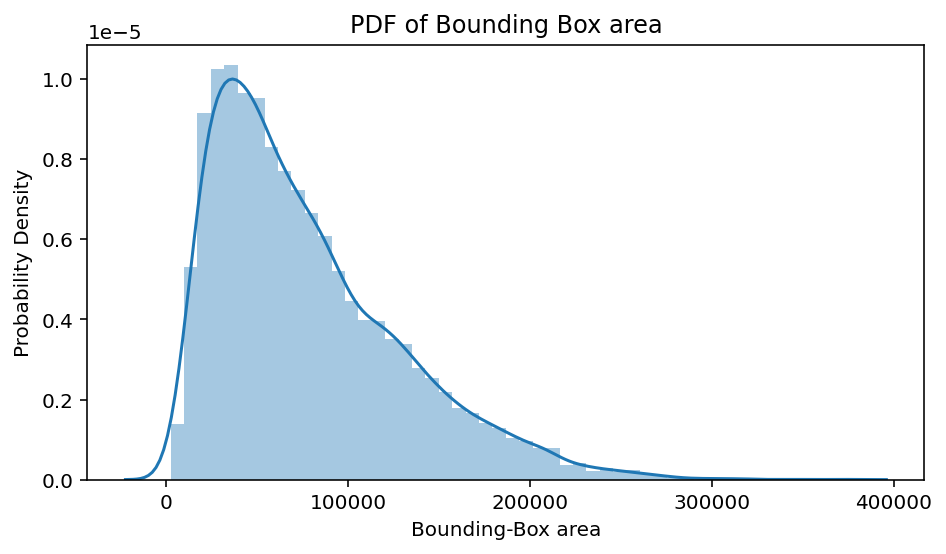

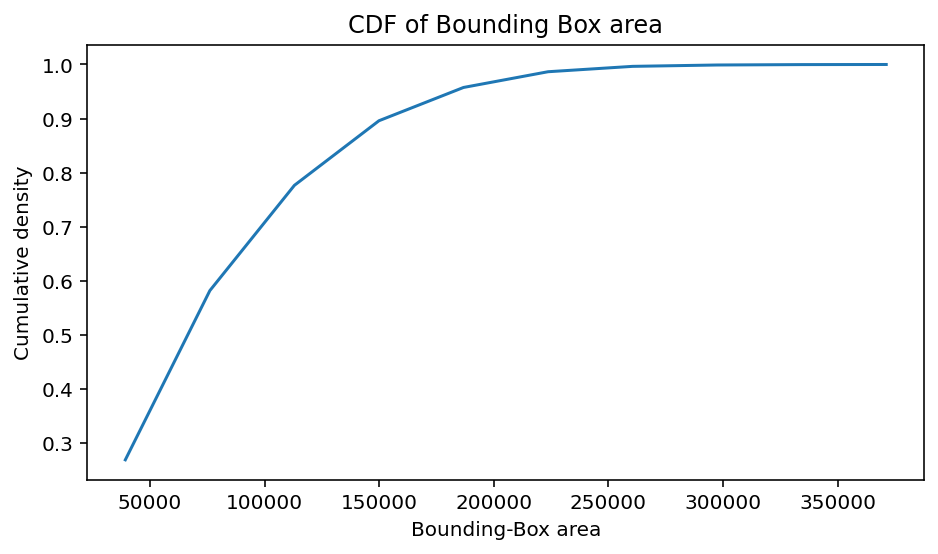

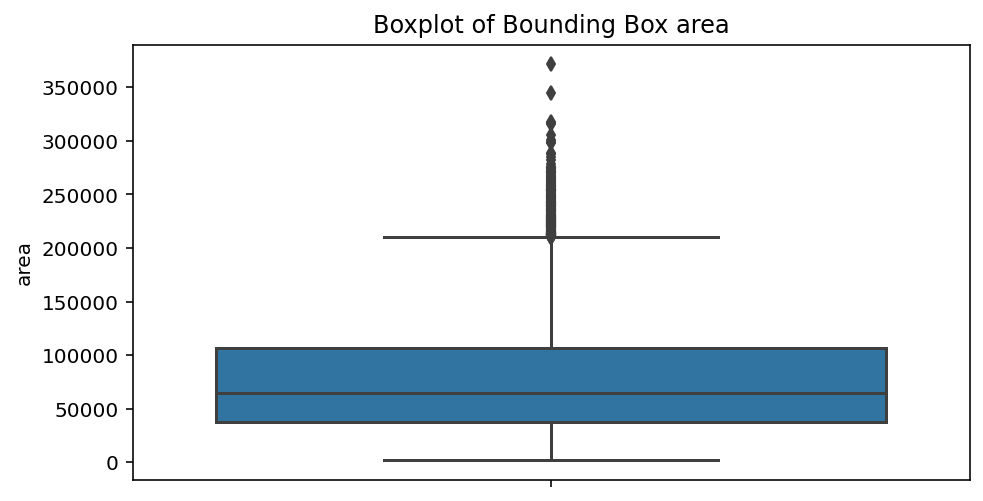

In [ ]:
plot_pdf(train_data.area.values,'Bounding-Box area','Probability Density','PDF of Bounding Box area')
plot_cdf(train_data['area'],'Bounding-Box area','Cumulative density','CDF of Bounding Box area')
box_plot(train_data,'area','Boxplot of Bounding Box area')

>**Observation:-**
1. The PDF of the bounding box bounding-box area that we got is positively skewed.
2. The general minimum & maximum values that we got is 0 & 200000px (pixels) respectively.
3. Almost 99% values are less than 250000.
4. The IQR(interquartile range) that we got is from 25000 to 100000 respectively.
5. There are certain outliers above 200000.

#### 3.7 Bounding Box Aspect Ratio

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


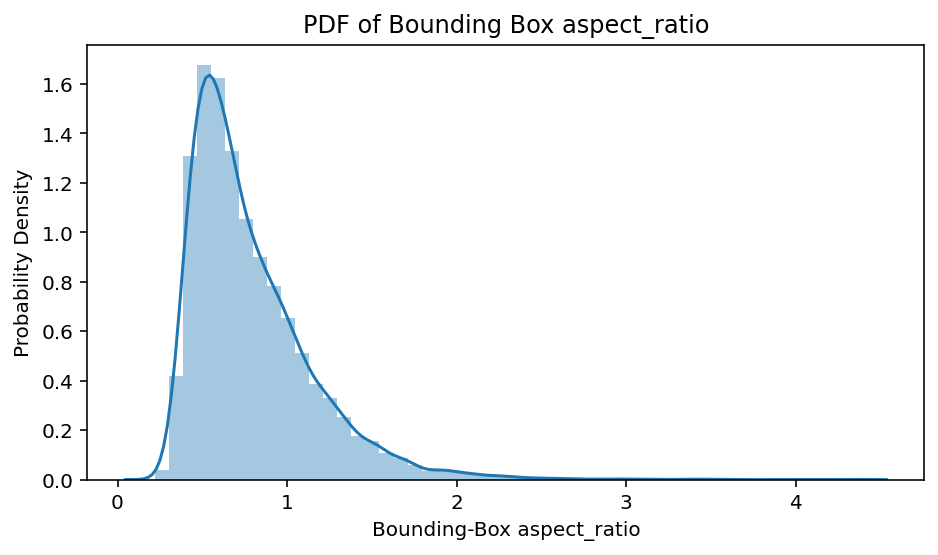

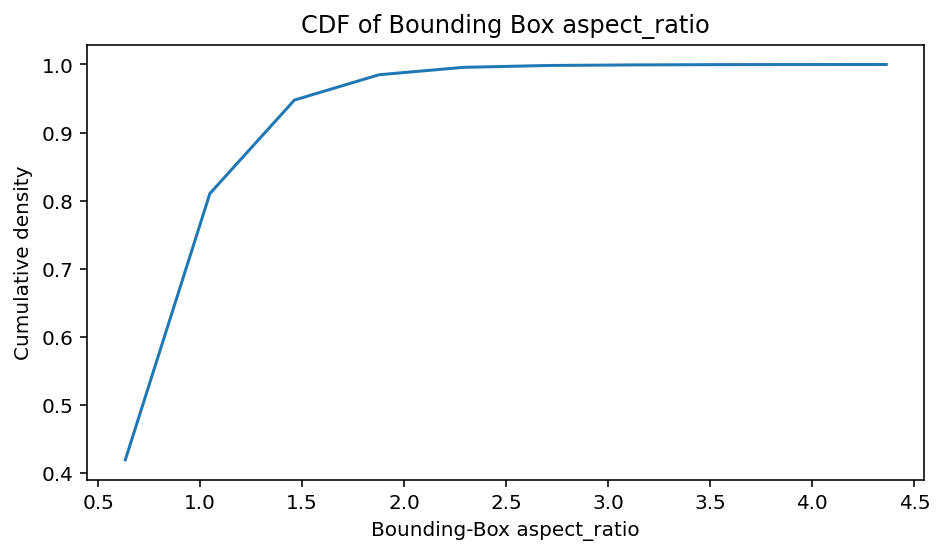

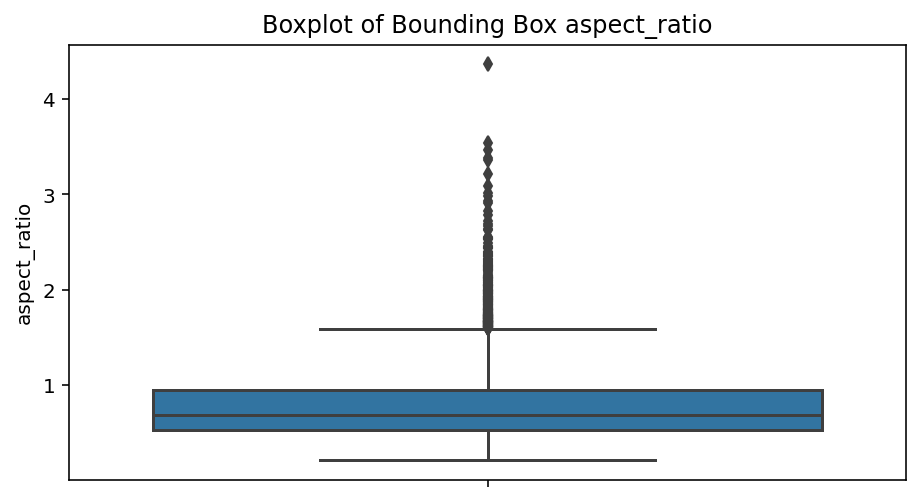

In [ ]:
plot_pdf(train_data.aspect_ratio.values,'Bounding-Box aspect_ratio','Probability Density','PDF of Bounding Box aspect_ratio')
plot_cdf(train_data['aspect_ratio'],'Bounding-Box aspect_ratio','Cumulative density','CDF of Bounding Box aspect_ratio')
box_plot(train_data,'aspect_ratio','Boxplot of Bounding Box aspect_ratio')

>**Observation:-**
1. The PDF of the bounding box bounding-box area that we got is positively skewed.
2. The general minimum & maximum values that we got is 0 & 2 respectively.
3. Almost 99% values are less than 2.
4. The IQR(interquartile range) that we got is from 0.5 to 1 respectively.
5. There are certain outliers above 1.75.

#### 3.8 Patient's Age

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


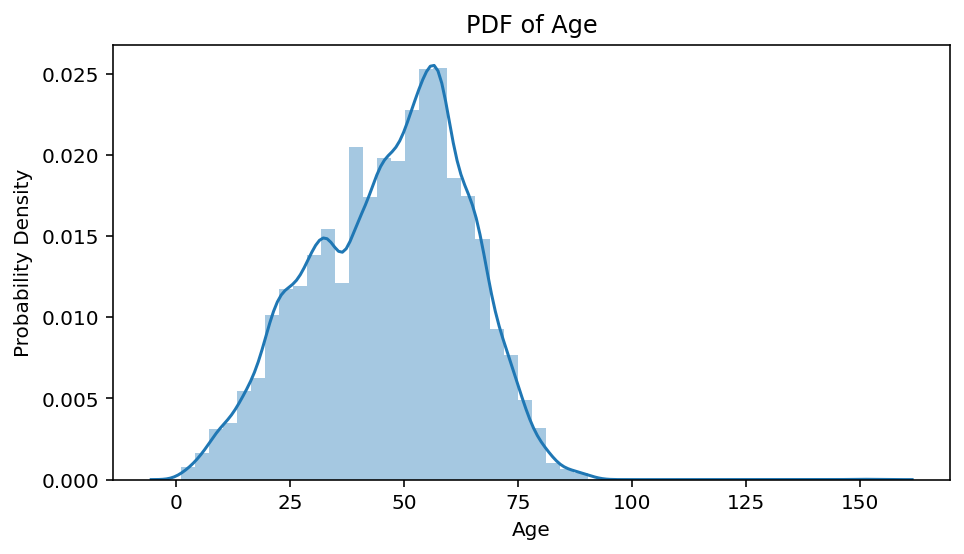

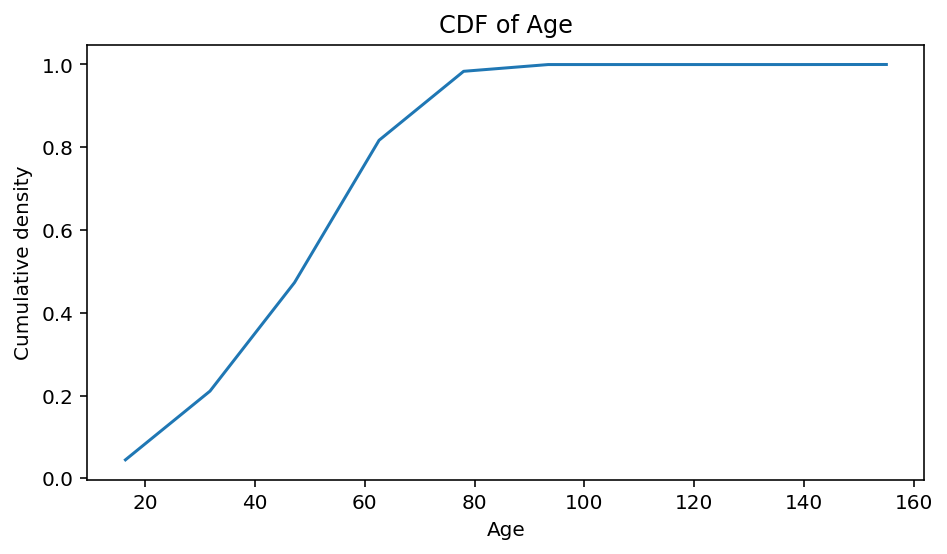

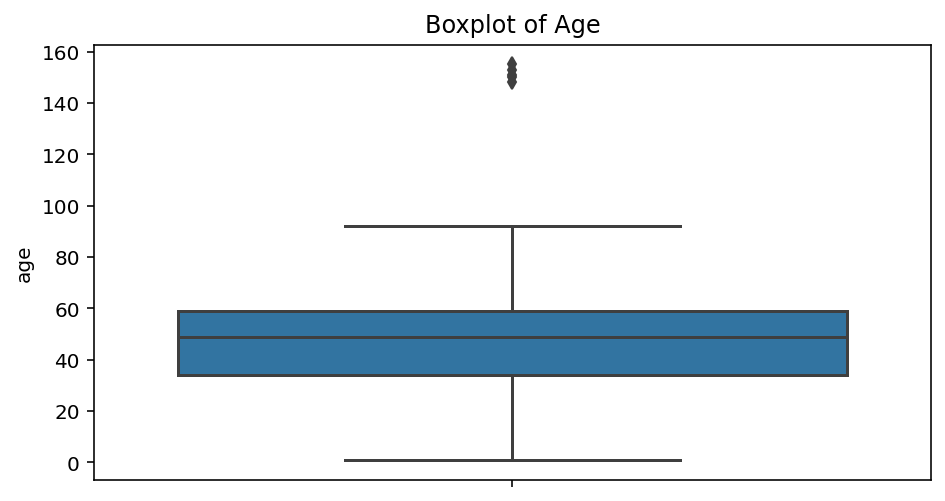

In [ ]:
plot_pdf(train_data.age.values,'Age','Probability Density','PDF of Age')
plot_cdf(train_data['age'],'Age','Cumulative density','CDF of Age')
box_plot(train_data,'age','Boxplot of Age')

>**Observation:-**
1. The range of patient's age is from 15 to 95 years.
2. There are certain values beween 140 and 160 years which are certainly outliers.
3. The age group from 30 to 95 is highly prone to the disease.
4. The IQR range is from 30 to 60 years respectively.
5. The median age of the patients is 50 years.

#### 3.9 Age distribution by gendre and target

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

Text(0.5, 1.02, 'Age distribution by gender and target')

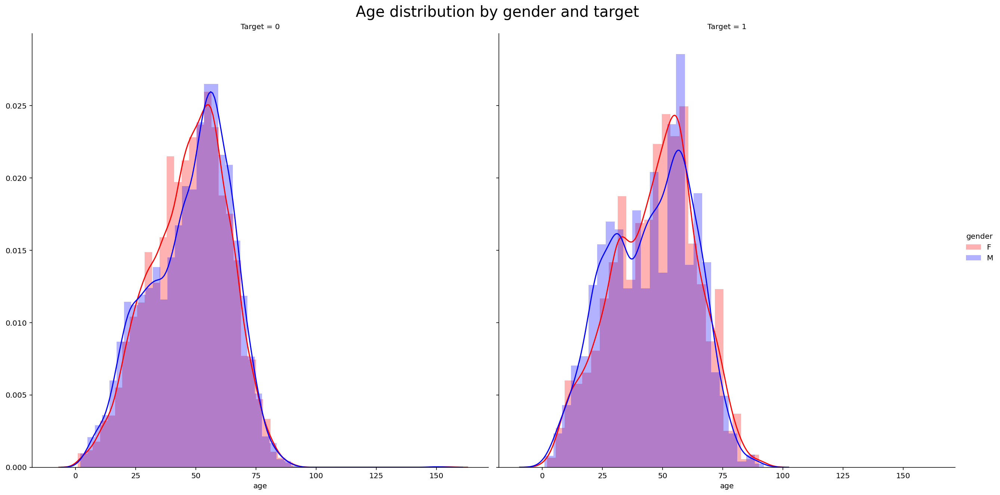

In [ ]:
g = sns.FacetGrid(col='Target', hue='gender', 
                  data=train_data.drop_duplicates(subset=['patientId']), 
                  height=9, palette=dict(F="red", M="blue"))
g.map(sns.distplot, 'age', hist_kws={'alpha': 0.3}).add_legend()
g.fig.suptitle("Age distribution by gender and target", y=1.02, fontsize=20)

>**Observation**:-
1. There is perfect overlap between the distribution of both the genders for both Target=0 & Target=1.
2. Both the relations looks almost same, it explains fact that both Target = 0 & Target = 1 follows same trend in terms of age. 
2. It explains the fact that there isn't any specif relation between the disease & the gendre.
3. Even when we compare this target & gendre based plot with the above explained overall age based plot we can easily observe that both are following same trend regardless of gendre & target.

## 4.Bivariate Analysis 

#### 4.1 Bounding Box Centroid plot (to detect outliers bounding boxes)

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


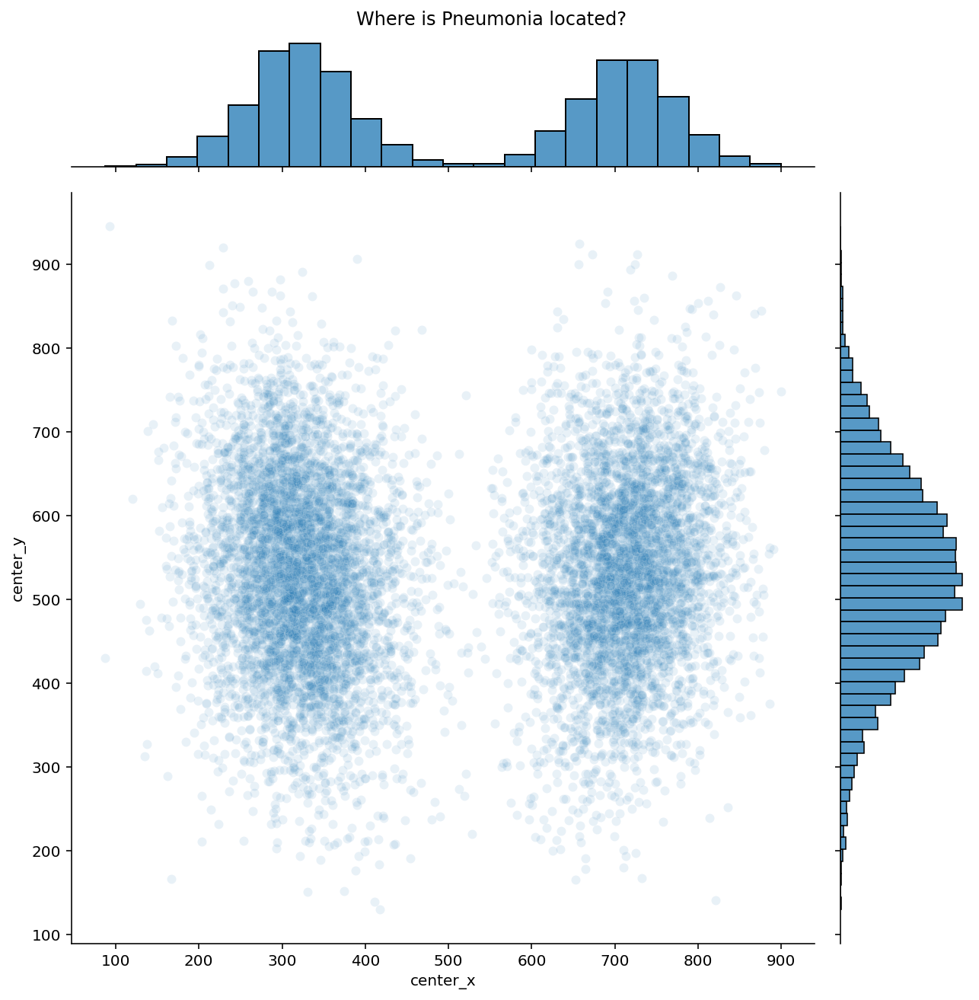

In [ ]:
tr = train_data[train_data['Target']==1]
centers = (tr.dropna(subset=['x'])
           .assign(center_x=tr.x + tr.width / 2, center_y=tr.y + tr.height / 2))
ax = sns.jointplot("center_x", "center_y", data=centers, height=9, alpha=0.1)
_ = ax.fig.suptitle("Where is Pneumonia located?", y=1.01)

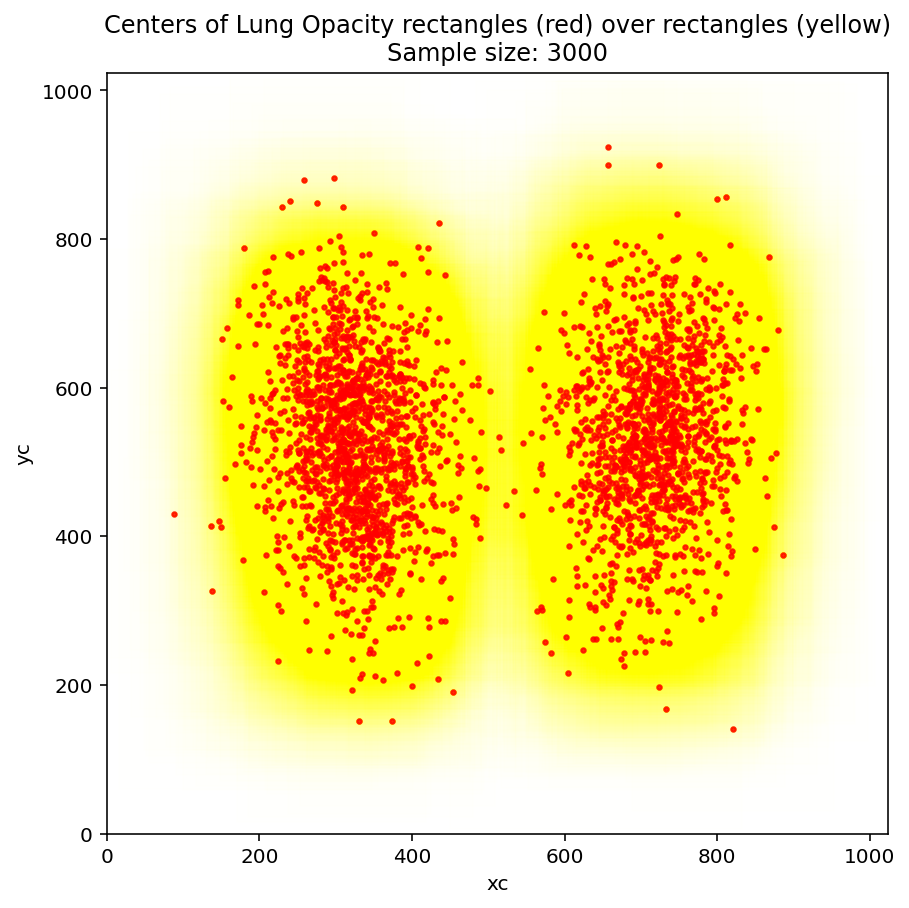

In [ ]:
tmp = detailed_data[detailed_data['Target']==1].sample(3000)

tmp['xc'] = tmp['x'] + tmp['width'] / 2
tmp['yc'] = tmp['y'] + tmp['height'] / 2
tmp['Area'] = tmp['height']*tmp['width']

fig, ax = plt.subplots(1,1,figsize=(7,7))
plt.title("Centers of Lung Opacity rectangles (red) over rectangles (yellow)\nSample size: 3000")
tmp.plot.scatter(x='xc', y='yc', xlim=(0,1024), ylim=(0,1024), ax=ax, alpha=0.8, marker=".", color="red")
for i, crt_sample in tmp.iterrows():
    ax.add_patch(Rectangle(xy=(crt_sample['x'], crt_sample['y']),
                width=crt_sample['width'],height=crt_sample['height'],alpha=3.5e-3, color="yellow"))
plt.show()

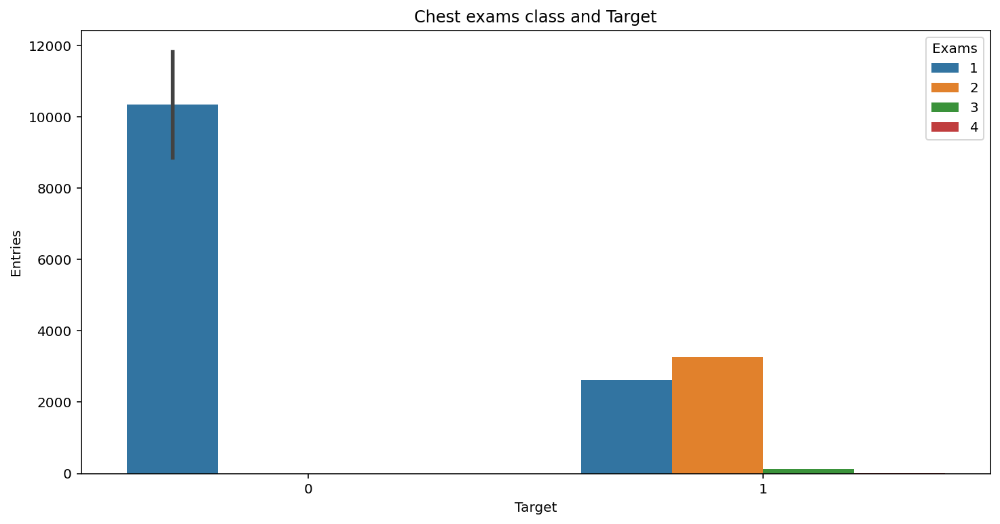

In [ ]:
tmp = detailed_data.groupby(['patientId','Target', 'class'])['patientId'].count()
df = pd.DataFrame(data={'Exams': tmp.values}, index=tmp.index).reset_index()
tmp = df.groupby(['Exams','Target','class']).count()
df2 = pd.DataFrame(data=tmp.values, index=tmp.index).reset_index()
df2.columns = ['Exams', 'Target','Class', 'Entries']

fig, ax = plt.subplots(nrows=1,figsize=(12,6))
sns.barplot(x = 'Target', y='Entries', hue='Exams',data=df2)
plt.title("Chest exams class and Target")
plt.show()

In [ ]:
# getting centres of bounding boxes
centers = (train_data.dropna(subset=['x'])
           .assign(center_x=train_data.x + train_data.width / 2, center_y=train_data.y + train_data.height / 2))

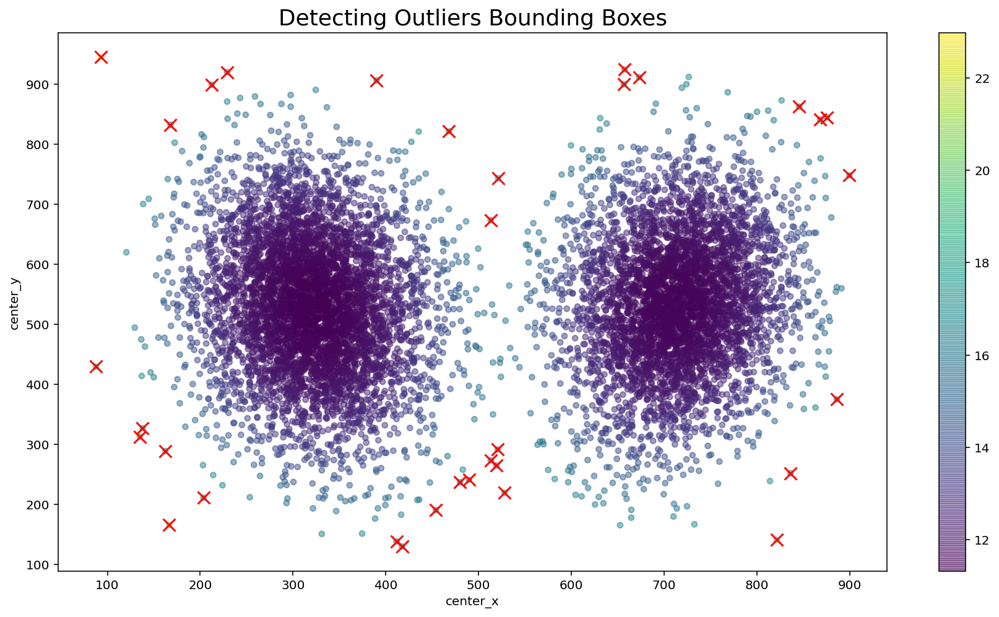

In [ ]:
# GaussianMixture for clustering 
from sklearn.mixture import GaussianMixture
clf = GaussianMixture(n_components=2)
clf.fit(centers[['center_x', 'center_y']])
center_probs = clf.predict_proba(centers[['center_x', 'center_y']])
Z = -clf.score_samples(centers[['center_x', 'center_y']])
outliers = centers.iloc[Z > 17]
fig, ax = plt.subplots(figsize=(15,8))
centers.plot.scatter('center_x', 'center_y', c=Z, alpha=0.5, cmap='viridis', ax=ax)
outliers.plot.scatter('center_x', 'center_y', c='red', marker='x', s=100, ax=ax)
_ = ax.set_title('Detecting Outliers Bounding Boxes', fontsize=18)

>**Observation:-**
1. We can observe that the central area of both the lungs are highly dense, having maximum numbers of bounding box centroids.
2. As soon as we are moving away from the centre, the bounding box density is gradually decreasing.
3. The red crosses that we can see on the outskerts of the lungs are outliers.
4. By removing those outlier values, we can get rid of the effect of outliers.

#### 4.2 Aspect ration vs Area

Text(0.5, 1.005, "The relationship between the bounding box's aspect ratio and area")

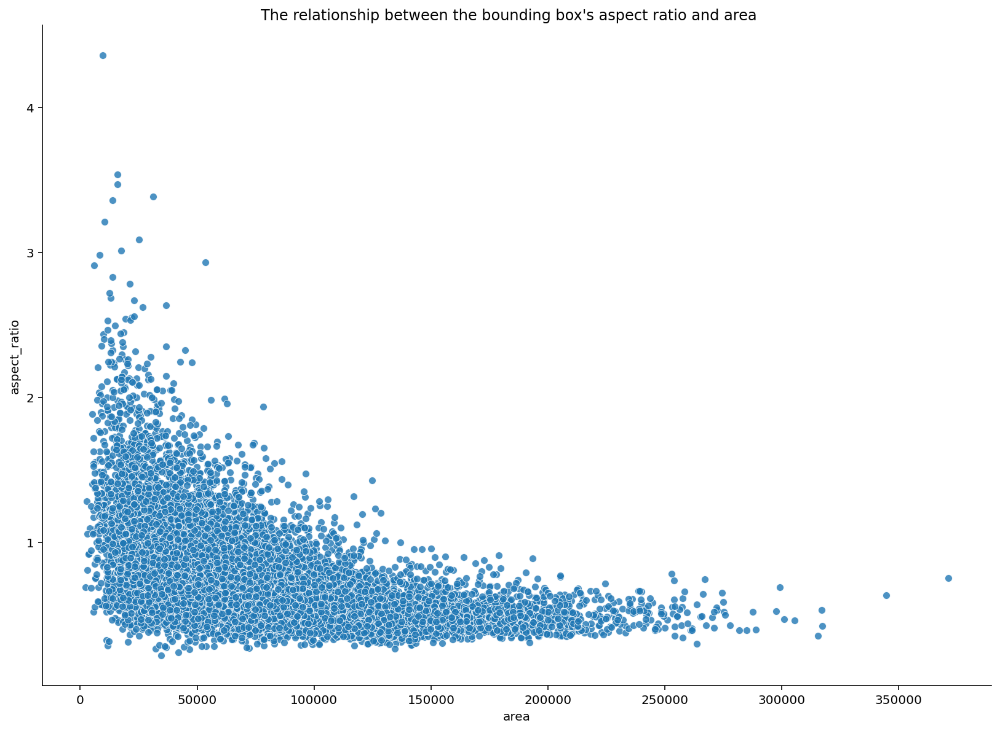

In [ ]:
g = sns.relplot(x='area', y='aspect_ratio', 
            data=train_data.dropna(subset=['area', 'aspect_ratio']), 
            height=8, alpha=0.8, aspect=1.4,)
g.fig.suptitle("The relationship between the bounding box's aspect ratio and area", y=1.005)

>**Observation:-**
1. The plot depicts an inversly prportional relation between the bounding aspect ratio and area.
2. As soon as the aspect ratio is increasing the area is decreasingnad vice-versa.
3. The bounding boxes having maximum heights  have small width & vise-varsa.
4. There are certain bounding boxes having very high apsect ratios.<br>

**---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------**

# Feature Engineering & Modelling

## Preprocessing

In [ ]:
import pydicom as dicom
import os
import cv2
import PIL # optional
from tqdm import tqdm
import pathlib
import pandas as pd
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.applications.densenet import DenseNet121
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import f1_score,roc_auc_score
from tensorflow.keras.utils import plot_model,to_categorical
from tensorflow.keras.initializers import he_normal,glorot_normal
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Dropout, Dense, Flatten, Conv2D,MaxPool2D,Dropout,BatchNormalization
from tensorflow.keras.callbacks import TensorBoard,ModelCheckpoint,EarlyStopping,ReduceLROnPlateau
from tensorflow.keras.applications import VGG19,ResNet50
import albumentations as A
import datetime
import random

In [ ]:
# to covert dicom files to im images
def dicom_to_jpg(source_folder,destination_folder,labels):
    images_path = os.listdir(source_folder)
    image_dirs_label = {'image_dir':[],'Target':[]}
    for n, image in tqdm(enumerate(images_path)):
        ds = dicom.dcmread(os.path.join(source_folder, image))
        pixel_array_numpy = ds.pixel_array
        image = image.replace('.dcm', '.jpg')
        cv2.imwrite(os.path.join(destination_folder, image), pixel_array_numpy)
        image_dirs_label['image_dir'].append(os.path.join(destination_folder, image))
        image_dirs_label['Target'].append(train_labels[train_labels.patientId== image.split('.')[0]].Target.values[0])
    print('{} dicom files converted to jpg!'.format(len(images_path)))
    return pd.DataFrame(image_dirs_label)

In [ ]:
# function to calculate recall
# refernce https://datascience.stackexchange.com/a/45166
def recall_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        recall = true_positives / (possible_positives + K.epsilon())
        return recall

# function to calculate precision
def precision_m(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision

# function to calculate micro averaged f1_score
def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

In [ ]:
# to visualize images
def visualize(image):
    plt.figure(figsize=(10, 10))
    plt.axis('off')
    plt.imshow(image)


In [ ]:
# reading train labels & removing duplicates
#train_data = pd.read_csv(PATH+'/stage_2_train_labels.csv')
#train_labels = train_data[['patientId','Target']].drop_duplicates()
#train_labels.to_csv(PATH+'/train_labels.csv',index=False)

In [ ]:
# converting dicoms to images
#train_dirs_label = dicom_to_jpg(PATH+"/stage_2_train_images",PATH+"/train_jpg_images",train_labels)

In [ ]:
train_dirs_label = pd.read_csv(PATH+'/train_dirs_label.csv')

In [ ]:
train_dirs_label.head()

,image_dir,Target
0,../content/drive/My Drive/Colab Notebooks/caps...,0
1,../content/drive/My Drive/Colab Notebooks/caps...,0
2,../content/drive/My Drive/Colab Notebooks/caps...,0
3,../content/drive/My Drive/Colab Notebooks/caps...,1
4,../content/drive/My Drive/Colab Notebooks/caps...,0


In [ ]:
# reading path_label csv
train_dirs_label = pd.read_csv(PATH+'/train_dirs_label.csv',dtype='str')

# shuffeling 
train_dirs_label = train_dirs_label.sample(frac = 1)


datagen=ImageDataGenerator(
        rescale=1./255.,
        rotation_range = 40, 
        shear_range = 0.2, 
        zoom_range = 0.2, 
        horizontal_flip = True,
        validation_split=0.30, 
        brightness_range = (0.5, 1.5) )

train_generator=datagen.flow_from_dataframe(
dataframe=train_dirs_label,
x_col="image_dir",
y_col="Target",
subset="training",
batch_size=4,
seed=42,
shuffle=True,
class_mode="binary",
target_size=(416,416))

valid_generator=datagen.flow_from_dataframe(
dataframe=train_dirs_label,
x_col="image_dir",
y_col="Target",
subset="validation",
batch_size=4,
seed=42,
shuffle=True,
class_mode="binary",
target_size=(416,416))

/usr/local/lib/python3.6/dist-packages/keras_preprocessing/image/dataframe_iterator.py:282: UserWarning: Found 302 invalid image filename(s) in x_col="image_dir". These filename(s) will be ignored.
  .format(n_invalid, x_col)


Found 18468 validated image filenames belonging to 2 classes.
Found 7914 validated image filenames belonging to 2 classes.


/usr/local/lib/python3.6/dist-packages/keras_preprocessing/image/dataframe_iterator.py:282: UserWarning: Found 302 invalid image filename(s) in x_col="image_dir". These filename(s) will be ignored.
  .format(n_invalid, x_col)


#VGG19 & ResNet50 Implementation for Pneumonia Detection

In [ ]:
# Define the VGG19 model pre-loaded with imagenet weights with last layer set as false
input_shape = (224, 224, 3)
num_of_class=1
img_in = Input(input_shape)       
model = VGG19(include_top= False ,
                weights='/content/drive/My Drive/Colab Notebooks/capstone/rsna-pneumonia-detection-challenge/vgg19_weights_tf_dim_ordering_tf_kernels_notop.h5',    
                input_tensor= img_in, 
                input_shape= input_shape,
                pooling ='avg') 

# The pre-trained model has classification output for 14 categories and hence Dense layer is defined with layer 1
x = model.output  
predictions = Dense(1, activation="sigmoid", name="predictions")(x)    
model = Model(inputs=img_in, outputs=predictions)

In [ ]:
# Print the model summary
model.summary()

Model: "functional_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)     

In [ ]:
#Set Early stopping parameter and Reduce Learning rate on Plateau
callbacks_list = [EarlyStopping(monitor='val_loss',patience=5,),
                  ModelCheckpoint(filepath='/content/drive/My Drive/Colab Notebooks/capstone/rsna-pneumonia-detection-challenge/my_model_VGG.h5',monitor='val_loss',save_best_only=True,),
                  ReduceLROnPlateau(monitor='val_loss',factor=0.1,patience=2,)]

In [ ]:
# Set only the last layer as Trainable
def model_train_layers(model,layer_name):
    model.trainable = True
    set_trainable = False
    for layer in model.layers:
        
        if layer.name == layer_name:
            set_trainable = True
            #print(layer.name)
        if set_trainable:
             layer.trainable = True
        else:
             layer.trainable = False

In [ ]:
model_train_layers(model,"predictions")

In [ ]:
# Compile with binary cross entropy loss
optimizer = Adam(lr=0.001)
model.compile(optimizer=optimizer, loss="binary_crossentropy", metrics=['acc',f1_m,precision_m, recall_m])

In [ ]:
# Run Fit Generator
history=model.fit_generator(generator=train_generator,
                    epochs=3,
                    validation_data=valid_generator,
                    callbacks=callbacks_list)

In [ ]:
model.save_weights('model_weights_vgg19.h5')

In [ ]:
model.save('model_vgg19.h5')

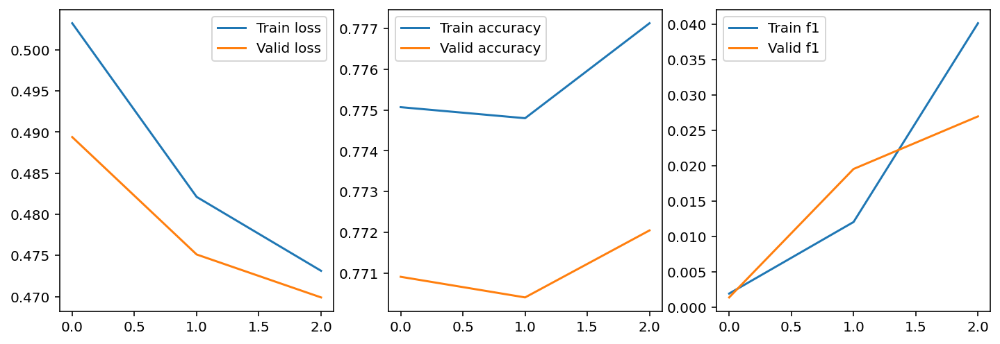

In [ ]:
plt.figure(figsize=(12,4))
plt.subplot(131)
plt.plot(history.epoch, history.history["loss"], label="Train loss")
plt.plot(history.epoch, history.history["val_loss"], label="Valid loss")
plt.legend()
plt.subplot(132)
plt.plot(history.epoch, history.history["acc"], label="Train accuracy")
plt.plot(history.epoch, history.history["val_acc"], label="Valid accuracy")
plt.legend()
plt.subplot(133)
plt.plot(history.epoch, history.history["f1_m"], label="Train f1")
plt.plot(history.epoch, history.history["val_f1_m"], label="Valid f1")
plt.legend()

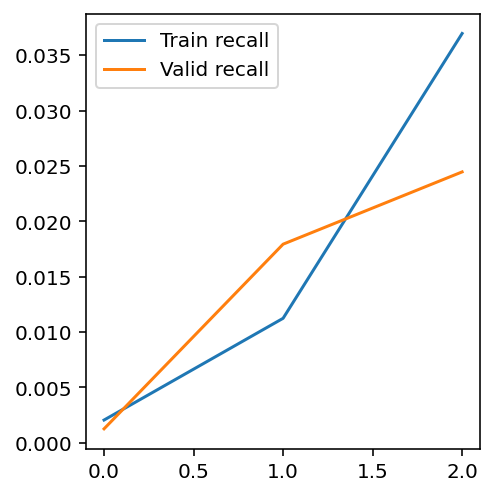

In [ ]:
plt.figure(figsize=(12,4))
plt.subplot(131)
plt.plot(history.epoch, history.history["recall_m"], label="Train recall")
plt.plot(history.epoch, history.history["val_recall_m"], label="Valid recall")
plt.legend()

In [ ]:
model.save_weights("model_vgg_weights.h5")

•	Vgg19 has very low f1 score in training. It’s a Basic Image classification model. So, We ignore this model for futher development.

##ResNet50

In [ ]:
# Define the ResNet50 model pre-loaded with imagenet weights with last layer set as false
input_shape = (224, 224, 3)
num_of_class=1
img_in = Input(input_shape)              
model = ResNet50(include_top= False, 
                weights='imagenet',    
                input_tensor= img_in, 
                input_shape= input_shape,
                pooling ='avg')

# The pre-trained model has classification output for 14 categories and hence Dense layer is defined with layer 1
x = model.output 
predictions = Dense(1, activation="sigmoid", name="predictions")(x)    
model = Model(inputs=img_in, outputs=predictions)

94773248/94765736 [==============================] - 3s 0us/step


In [ ]:
model.summary()

Model: "functional_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_8[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
______________________________________________________________________________________

In [ ]:
model_train_layers(model,"predictions")

In [ ]:
# Compile with binary cross entropy loss
optimizer = Adam(lr=0.001)
model.compile(optimizer=optimizer, loss="binary_crossentropy", metrics=['acc',f1_m,precision_m, recall_m])

In [ ]:
# Run Fit Generator
history=model.fit_generator(generator=train_generator,
                    epochs=3,
                    validation_data=valid_generator,
                    callbacks=callbacks_list)

Epoch 1/3
4617/4617 [==============================] - 1454s 315ms/step - loss: 0.5558 - acc: 0.7698 - f1_m: 0.0076 - precision_m: 0.0072 - recall_m: 0.0100 - val_loss: 0.5231 - val_acc: 0.7695 - val_f1_m: 0.0022 - val_precision_m: 0.0025 - val_recall_m: 0.0020
Epoch 2/3
4617/4617 [==============================] - 1441s 312ms/step - loss: 0.5394 - acc: 0.7684 - f1_m: 0.0143 - precision_m: 0.0142 - recall_m: 0.0176 - val_loss: 0.5268 - val_acc: 0.7698 - val_f1_m: 0.0036 - val_precision_m: 0.0051 - val_recall_m: 0.0029
Epoch 3/3
4617/4617 [==============================] - 1422s 308ms/step - loss: 0.5348 - acc: 0.7710 - f1_m: 0.0230 - precision_m: 0.0247 - recall_m: 0.0253 - val_loss: 0.5039 - val_acc: 0.7698 - val_f1_m: 8.4218e-04 - val_precision_m: 0.0010 - val_recall_m: 7.5796e-04


In [ ]:
model.save_weights("model_resnet_weights.h5")

In [ ]:
model.save("model_resnet.h5")

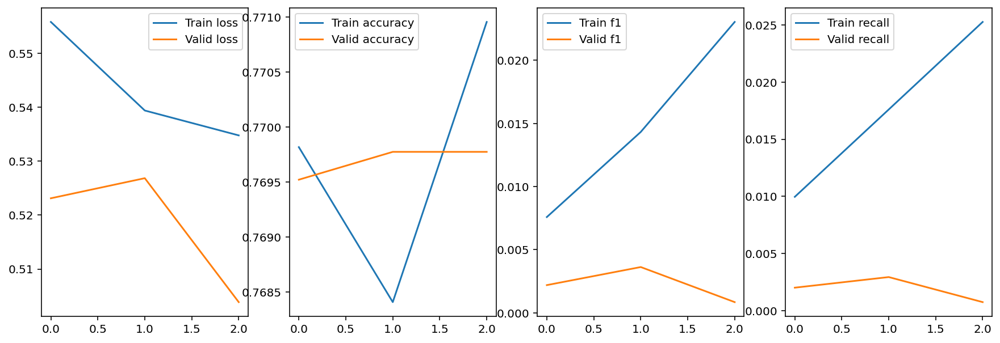

In [ ]:
#plt.figure(figsize=(15,5))
#plt.subplot(141)
#plt.plot(history.epoch, history.history["loss"], label="Train loss")
#plt.plot(history.epoch, history.history["val_loss"], label="Valid loss")
#plt.legend()
#plt.subplot(142)
#plt.plot(history.epoch, history.history["acc"], label="Train accuracy")
#plt.plot(history.epoch, history.history["val_acc"], label="Valid accuracy")
#plt.legend()
#plt.subplot(143)
#plt.plot(history.epoch, history.history["f1_m"], label="Train f1")
#plt.plot(history.epoch, history.history["val_f1_m"], label="Valid f1")
#plt.legend()
#plt.subplot(144)
#plt.plot(history.epoch, history.history["recall_m"], label="Train recall")
#plt.plot(history.epoch, history.history["val_recall_m"], label="Valid recall")
#plt.legend()

•	ResNet50 has also low f1 score.

## Classification Model (ChexNet i.e DensNet121)

In [ ]:
# setting up base model 
dense_net_121 = DenseNet121(input_shape=[416,416] + [3],include_top=False,pooling='avg')
base_model_output = Dense(units=14,activation='relu')(dense_net_121.output)
base_model = Model(inputs = dense_net_121.input,outputs=base_model_output)
base_model.load_weights(PATH+'/brucechou1983_CheXNet_Keras_0.3.0_weights.h5')

29089792/29084464 [==============================] - 1s 0us/step


In [ ]:
# freezing initial layers of base model
for layer in base_model.layers[:10]:
    layer.trainable = False

In [ ]:
base_model.summary()

Model: "functional_17"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, 422, 422, 3)  0           input_9[0][0]                    
__________________________________________________________________________________________________
conv1/conv (Conv2D)             (None, 208, 208, 64) 9408        zero_padding2d[0][0]             
__________________________________________________________________________________________________
conv1/bn (BatchNormalization)   (None, 208, 208, 64) 256         conv1/conv[0][0]                 
______________________________________________________________________________________

In [ ]:
# setting up final model 
output_layer = Dense(1,activation='sigmoid')(base_model.layers[-2].output)
model = Model(inputs=base_model.inputs, outputs=output_layer)
model.compile(optimizer='adam', loss='binary_crossentropy',metrics = ['accuracy',f1_m])

In [ ]:
model.summary()

Model: "functional_19"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, 422, 422, 3)  0           input_9[0][0]                    
__________________________________________________________________________________________________
conv1/conv (Conv2D)             (None, 208, 208, 64) 9408        zero_padding2d[0][0]             
__________________________________________________________________________________________________
conv1/bn (BatchNormalization)   (None, 208, 208, 64) 256         conv1/conv[0][0]                 
______________________________________________________________________________________

In [ ]:
# setting up callbacks
checkpoint = ModelCheckpoint(filepath='classifier_weights.hdf5', monitor='val_accuracy',  verbose=0, save_best_only=True,save_weights_only=True, mode='auto')
log_dir="classifier_logs/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard= TensorBoard(log_dir=log_dir, histogram_freq=1, write_graph=True,write_grads=True)
callback_list = [checkpoint,tensorboard]

In [ ]:
import warnings
warnings.filterwarnings("ignore")
# fit the model
history = model.fit(train_generator,
  validation_data=valid_generator,
  epochs=3,
  steps_per_epoch=len(train_generator),
  callbacks=callback_list)

Epoch 1/3
   1/4617 [..............................] - ETA: 3s - loss: 0.6653 - accuracy: 0.5000 - f1_m: 0.0000e+00WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
4617/4617 [==============================] - 1504s 326ms/step - loss: 0.4288 - accuracy: 0.8061 - f1_m: 0.2516 - val_loss: 0.3817 - val_accuracy: 0.8300 - val_f1_m: 0.3614
Epoch 2/3
4617/4617 [==============================] - 1451s 314ms/step - loss: 0.4022 - accuracy: 0.8177 - f1_m: 0.2970 - val_loss: 0.3846 - val_accuracy: 0.8270 - val_f1_m: 0.4200
Epoch 3/3
4617/4617 [==============================] - 1452s 315ms/step - loss: 0.3885 - accuracy: 0.8273 - f1_m: 0.3083 - val_loss: 0.3648 - val_accuracy: 0.8399 - val_f1_m: 0.3636


In [ ]:
# loading model 
#model = tf.keras.models.load_model('models and weights/chexnet_model.hdf5',custom_objects={'f1_m':f1_m})
# loading weights
#model.load_weights('models and weights/classifier_weights.hdf5')

In [ ]:
model.save_weights('chexnet_model_weights.hdf5')
# saving model
model.save('chexnet_model.hdf5')

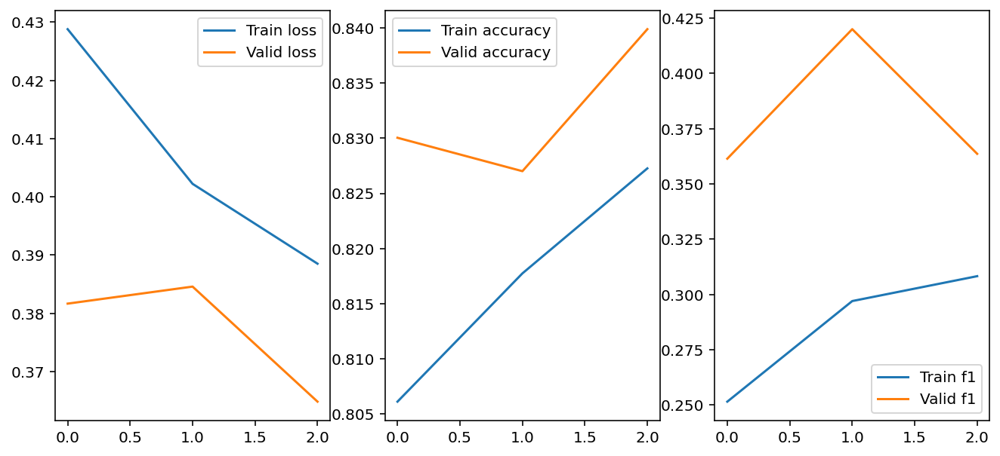

In [ ]:
plt.figure(figsize=(15,5))
plt.subplot(141)
plt.plot(history.epoch, history.history["loss"], label="Train loss")
plt.plot(history.epoch, history.history["val_loss"], label="Valid loss")
plt.legend()
plt.subplot(142)
plt.plot(history.epoch, history.history["accuracy"], label="Train accuracy")
plt.plot(history.epoch, history.history["val_accuracy"], label="Valid accuracy")
plt.legend()
plt.subplot(143)
plt.plot(history.epoch, history.history["f1_m"], label="Train f1")
plt.plot(history.epoch, history.history["val_f1_m"], label="Valid f1")
plt.legend()

## Approach & Summary:-
•	We have defined the DenseNet model preloaded with Dense121 Weights.

•	Input shape = 244,244,3

•	Model loaded with the pre-trained chexnet weights available from the git-hub “brucechou1983_CheXNet_Keras_0.3.0_weights.h5” 

•	we used pretrained ChexNet architecture initialized with trained weights by removing top layers to make it binary classifier.

•	We removed the last Dense layer with 14 classes and replaced with the Dense layer of 1 class.

•	ChexNet provides a average  F1 score which can be considered for further evaluation.



# Retina Net Implementation for Pneumonia Detection

In [ ]:
# Clone the git for RetinaNet implementation
!git clone "https://github.com/fizyr/keras-retinanet.git"

Cloning into 'keras-retinanet'...
remote: Enumerating objects: 9, done.
remote: Counting objects: 100% (9/9), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 6205 (delta 1), reused 3 (delta 1), pack-reused 6196
Receiving objects: 100% (6205/6205), 13.48 MiB | 13.05 MiB/s, done.
Resolving deltas: 100% (4196/4196), done.


In [ ]:
# Install the pre-requisites and import required libraries
!pip install pydicom
import glob, pylab, pandas as pd
import numpy as np
import matplotlib.image as image
import pydicom as dcm
from skimage.transform import resize

In [ ]:
%cd keras-retinanet

/content/keras-retinanet


In [ ]:
# Install the required directory
!pip install .

Processing /content/keras-retinanet
  Created wheel for keras-retinanet: filename=keras_retinanet-1.0.0-cp36-cp36m-linux_x86_64.whl size=168068 sha256=91635d67465f7e400e932c1f1d3a3cfbe31d00ae7d13856d19b0da3df5fc0c83
  Stored in directory: /root/.cache/pip/wheels/b2/9f/57/cb0305f6f5a41fc3c11ad67b8cedfbe9127775b563337827ba
  Created wheel for keras-resnet: filename=keras_resnet-0.2.0-py2.py3-none-any.whl size=20487 sha256=740fd78dfb22a04effb95e491609ee8265388d273795c96fe8dc28e086c68c40
  Stored in directory: /root/.cache/pip/wheels/5f/09/a5/497a30fd9ad9964e98a1254d1e164bcd1b8a5eda36197ecb3c
Successfully built keras-retinanet keras-resnet


In [ ]:
# Compile the script using the setup file
!python setup.py build_ext --inplace

running build_ext
cythoning keras_retinanet/utils/compute_overlap.pyx to keras_retinanet/utils/compute_overlap.c
/usr/local/lib/python3.6/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/keras-retinanet/keras_retinanet/utils/compute_overlap.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'keras_retinanet.utils.compute_overlap' extension
creating build
creating build/temp.linux-x86_64-3.6
creating build/temp.linux-x86_64-3.6/keras_retinanet
creating build/temp.linux-x86_64-3.6/keras_retinanet/utils
x86_64-linux-gnu-gcc -pthread -DNDEBUG -g -fwrapv -O2 -Wall -g -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/include/python3.6m -I/usr/local/lib/python3.6/dist-packages/numpy/core/include -c keras_retinanet/utils/compute_overlap.c -o build/temp.linux-x86_64-3.6/keras_retinanet/utils/compute_over

In [ ]:
# Filter records with pnuemonia cases
detailed_class_df=train_data[train_data['Target']==1]

In [ ]:
detailed_class_df.head()

,patientId,x,y,width,height,Target,aspect_ratio,area,age,gender
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1,0.562005,80727.0,32,F
5,00436515-870c-4b36-a041-de91049b9ab4,562.0,152.0,256.0,453.0,1,0.565121,115968.0,32,F
8,00704310-78a8-4b38-8475-49f4573b2dbb,323.0,577.0,160.0,104.0,1,1.538462,16640.0,75,M
9,00704310-78a8-4b38-8475-49f4573b2dbb,695.0,575.0,162.0,137.0,1,1.182482,22194.0,75,M
14,00aecb01-a116-45a2-956c-08d2fa55433f,288.0,322.0,94.0,135.0,1,0.696296,12690.0,6,F


In [ ]:
detailed_class_df.shape

(9555, 10)

In [ ]:
# Group images with different bounding boxes
def parse_data(df):
    extract_box = lambda row: [row['x'], row['y'], row['width'], row['height']]
    parsed = {}
    for n, row in df.iterrows():
        
        pid = row['patientId']
        if pid not in parsed:
            parsed[pid] = {
                'boxes': []}
        parsed[pid]['boxes'].append(extract_box(row))

    return parsed

In [ ]:
# Convert dcm file to JPEG for usage in RetinaNet
def converttoJpeg(patientId):
    dicom_file = dcm.read_file(inp_path+patientId+'.dcm')
    dicom_array = dicom_file.pixel_array
    image_array = resize(dicom_array, (512, 512), mode= 'constant', anti_aliasing=True)
    image.imsave(out_path+patientId+".jpg", dicom_array)

In [ ]:
# Get the first 4000 records for training
train_dict=parse_data(detailed_class_df.head(4000))

In [ ]:
len(train_dict)

2519

In [ ]:
#set path to the file location
out_path = '/content/drive/My Drive/Colab Notebooks/capstone/rsna-pneumonia-detection-challenge/JPEG/'
inp_path = '/content/drive/My Drive/Colab Notebooks/capstone/rsna-pneumonia-detection-challenge/stage_2_train_images/'

In [ ]:
# Create annotation file for the images of the format image_path,x1,y1,x2,y3,'pnenumonia'
# Create class label file of the format 'pneumonia',0
for patient_id in train_dict.keys():
    box =train_dict[patient_id]['boxes']
    #converttoJpeg(patient_id)
    path = out_path+patient_id+".jpg"
    for j in range(len(box)):
      x1 = int(box[j][0])             #Upper lef 
      x2 = int(box[j][0] + box[j][2])
      y1 = int(box[j][1])
      y2 = int(box[j][1] + box[j][3]) #Upper left y1 + height  
      towrite = str(path+ "," + str(x1) + ","+ str(y1)+","+ str(x2)+","+ str(y2)+",Pneumonia")
      with open("annotate.csv", "a") as wr:
            wr.write(towrite)
            wr.write('\n')
      with open("class.csv", "w") as wr:
            towrite = str("Pneumonia,0")
            wr.write(towrite)

In [ ]:
# Load pre-trained model weights
import urllib
#PRETRAINED_MODEL = './snapshots/_pretrained_model.h5'
PRETRAINED_MODEL = './snapshots/resnet50_csv_10.h5'
URL_MODEL = 'https://github.com/fizyr/keras-retinanet/releases/download/0.5.1/resnet50_coco_best_v2.1.0.h5'
urllib.request.urlretrieve(URL_MODEL, PRETRAINED_MODEL)

('./snapshots/resnet50_csv_10.h5', <http.client.HTTPMessage at 0x7f1b466d2e48>)

In [ ]:
!pip install keras==2.4.0

     |████████████████████████████████| 174kB 13.8MB/s 
  Found existing installation: Keras 2.4.3
    Uninstalling Keras-2.4.3:
      Successfully uninstalled Keras-2.4.3


In [ ]:
!pwd

/content/keras-retinanet


In [ ]:
#!keras_retinanet/bin/train.py --freeze-backbone --random-transform --weights {PRETRAINED_MODEL} --batch-size 32 --steps 79 --epochs 10 csv annotate.csv class.csv

In [ ]:
#!keras_retinanet/bin/evaluate.py  csv annotate.csv class.csv /content/drive/My Drive/Colab Notebooks/capstone/rsna-pneumonia-detection-challenge/resnet50_csv_10.h5 --convert-model

In [ ]:
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color
import matplotlib.pyplot as plt
import cv2

In [ ]:
model_path='/content/drive/MyDrive/Colab Notebooks/capstone/rsna-pneumonia-detection-challenge/resnet50_csv_10.h5'
model = models.load_model(model_path, backbone_name='resnet50')
model = models.convert_model(model)

#model.save("Renitanet.h5")

Using TensorFlow backend.


In [ ]:
THRES_SCORE = 0.4

In [ ]:
def draw_image(patient_id):
  pred_box=[]
  actual_box=[]
  file_path = out_path + patient_id+'.jpg'
  image = read_image_bgr(file_path)

  draw = image.copy()
  draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

  image = preprocess_image(image)
  image, scale = resize_image(image)

  pred_boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))

  pred_boxes /= scale
  
  data = train_dict[patient_id]
  actual_boxes = data['boxes']
  #print(actual_boxes)  
  for box, score, label in zip(pred_boxes[0], scores[0], labels[0]):
      if score < THRES_SCORE:
          break
      #print(box)
      color = label_color(label)
      #print(color)
      b = box.astype(int)
      pred_box.append(np.array(b).tolist())
      draw_box(draw, b, color=color)
      caption = "{} {:.2f}".format('pnuemonia', score)
      draw_caption(draw, b, caption)
  for box in actual_boxes:
     box = [int(b) for b in box]
     x1, y1, width, height = box
     y2 = y1 + height
     x2 = x1 + width
     box = [x1,y1,x2,y2]
     actual_box.append(box)
     draw_box(draw, box, color=cv2.IMREAD_COLOR)
  iou_list=[]
  for box_a in pred_box:
    for box_b in actual_box:
       iou=bb_intersection_over_union(box_a, box_b)
       iou_list.append(iou)
  mean_iou = sum(iou_list)/len(actual_box)
  print("Mean_IOU::" + str(mean_iou))
  plt.figure(figsize=(10, 10))
  plt.axis('off')
  plt.imshow(draw)
  plt.show()

In [ ]:
def bb_intersection_over_union(boxA, boxB):
	# determine the (x, y)-coordinates of the intersection rectangle
	xA = max(boxA[0], boxB[0])
	yA = max(boxA[1], boxB[1])
	xB = min(boxA[2], boxB[2])
	yB = min(boxA[3], boxB[3])
 
	# compute the area of intersection rectangle
	interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
 
	# compute the area of both the prediction and ground-truth
	# rectangles
	boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
	boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
 
	# compute the intersection over union by taking the intersection
	# area and dividing it by the sum of prediction + ground-truth
	# areas - the interesection area
	iou = interArea / float(boxAArea + boxBArea - interArea)
 
	# return the intersection over union value
	return iou

Mean_IOU::0.28924581041490055


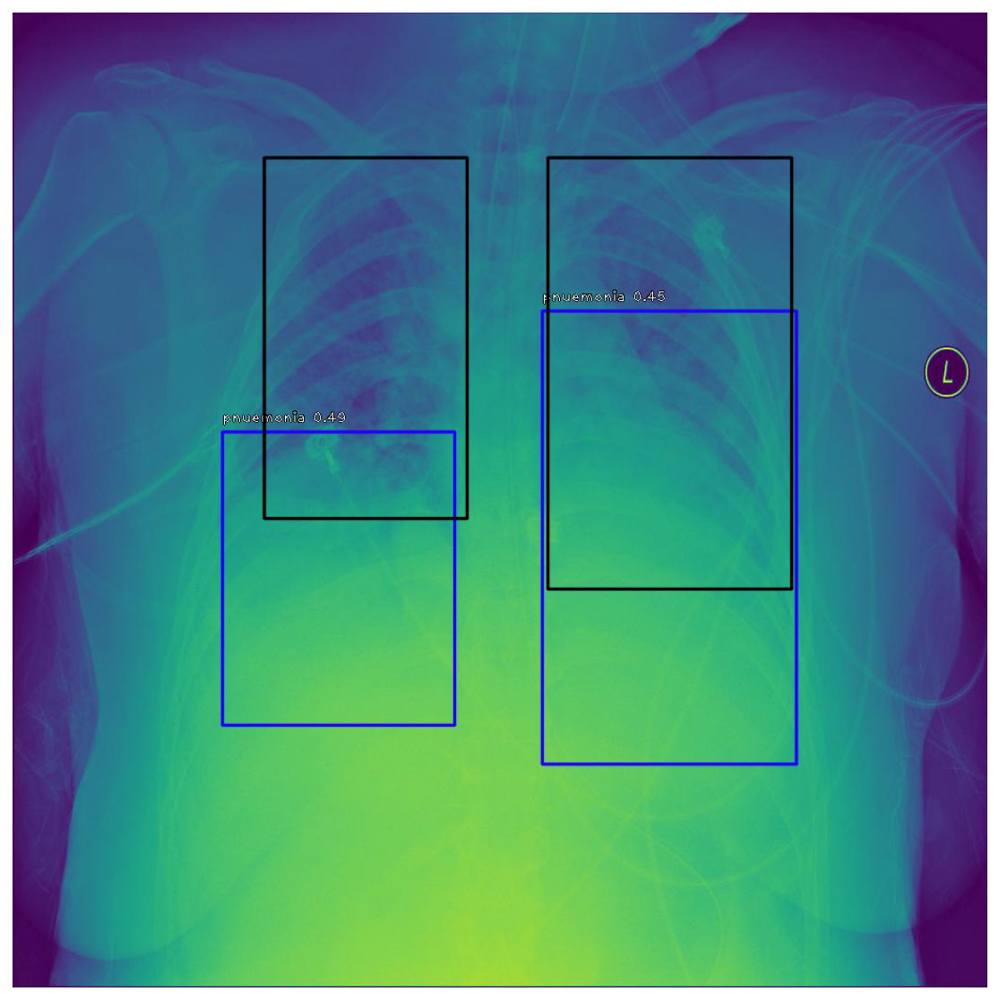

In [ ]:
#Black Boxes - Actual
#Blue Boxes  - Predicted
THRES_SCORE = 0.4
patient_id='00436515-870c-4b36-a041-de91049b9ab4'
draw_image(patient_id)

Mean_IOU::0.25427080231030996


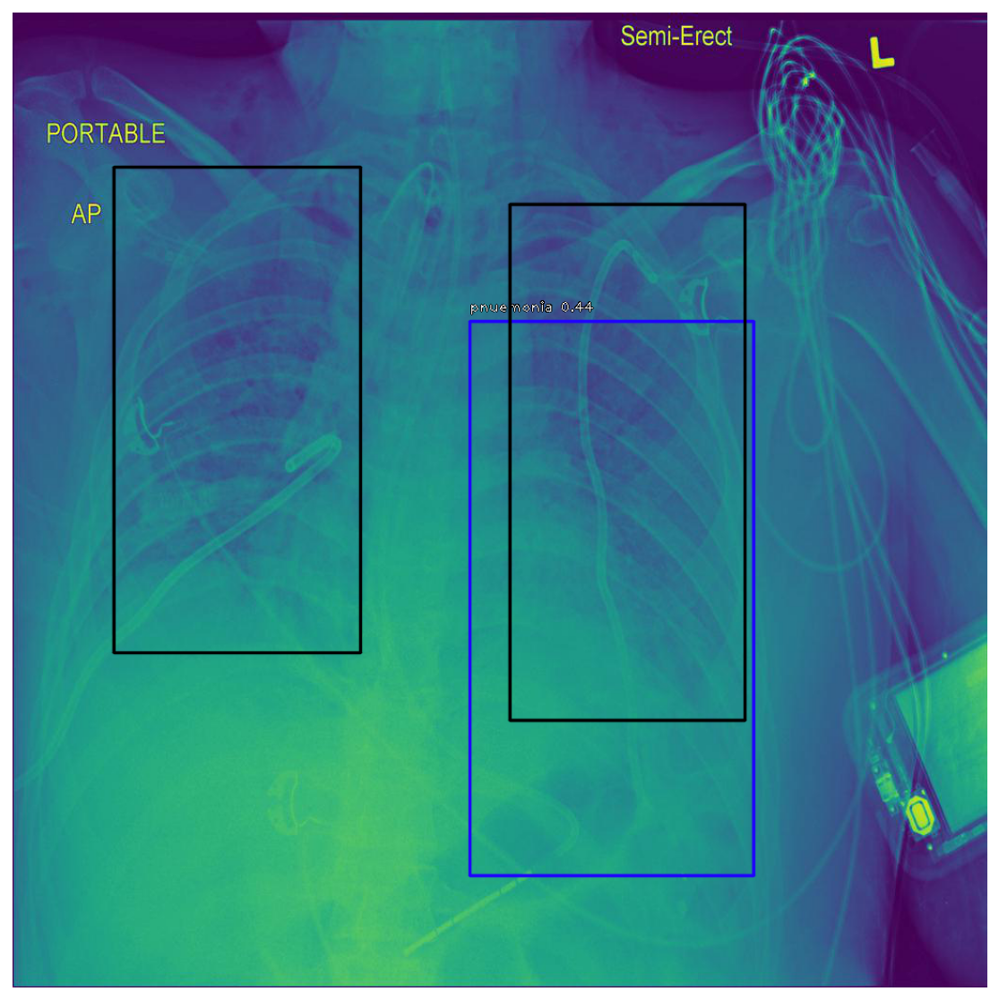

In [ ]:
THRES_SCORE = 0.4
patient_id='8047b765-c93a-4059-8a09-9b1e809809e7'
draw_image(patient_id)

Mean_IOU::0.5817208178091156


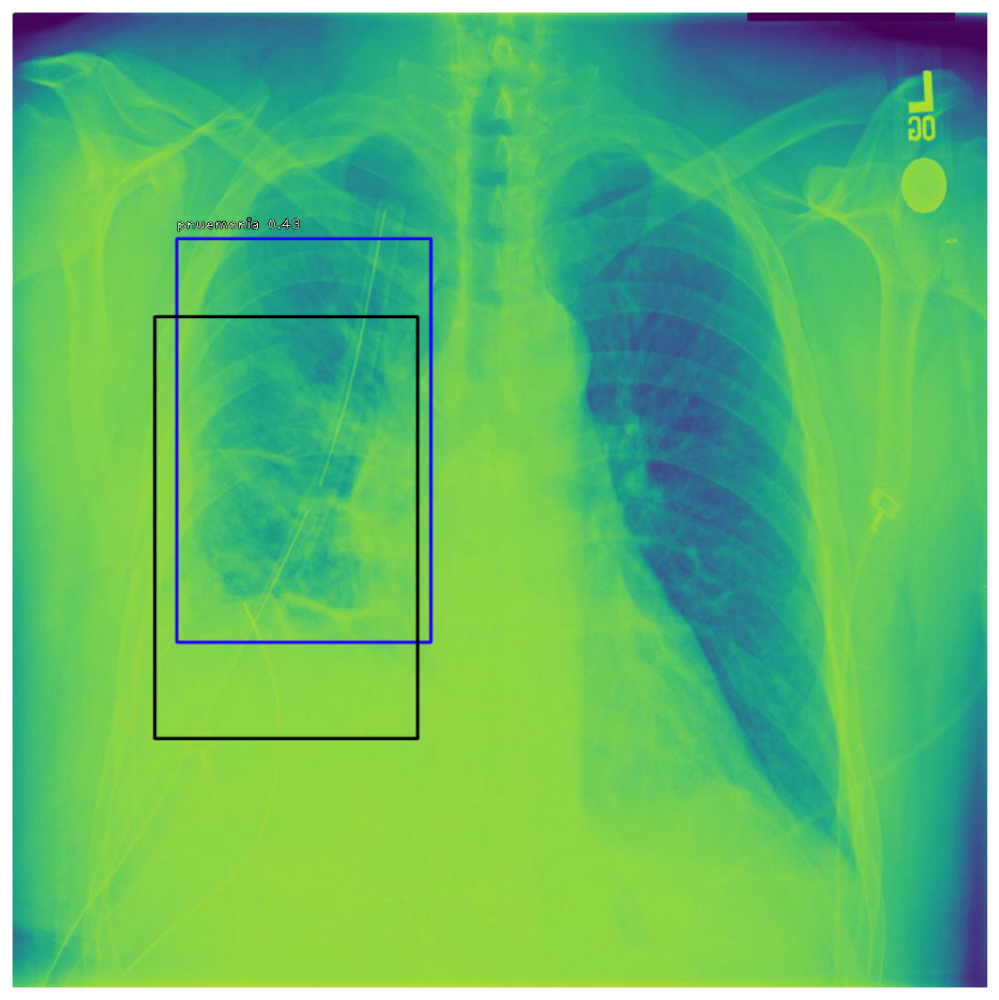

In [ ]:
THRES_SCORE = 0.4
patient_id='8192a218-3ed8-450a-bb3e-052e36567763'
draw_image(patient_id)

Mean_IOU::0.6565929483972114


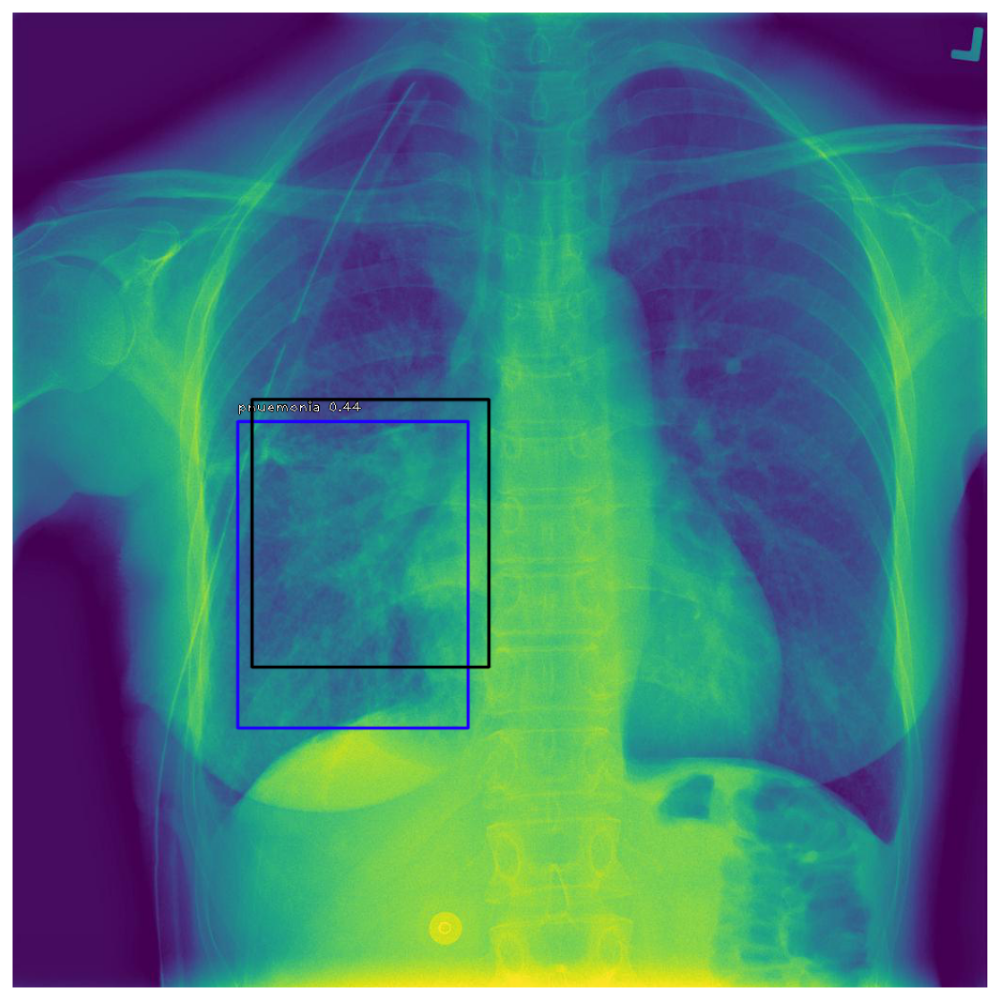

In [ ]:
THRES_SCORE =0.4
patient_id='815dd1c1-3e01-4038-9723-39d05e8b3cd3'
draw_image(patient_id)

Mean_IOU::0.33339518772808807


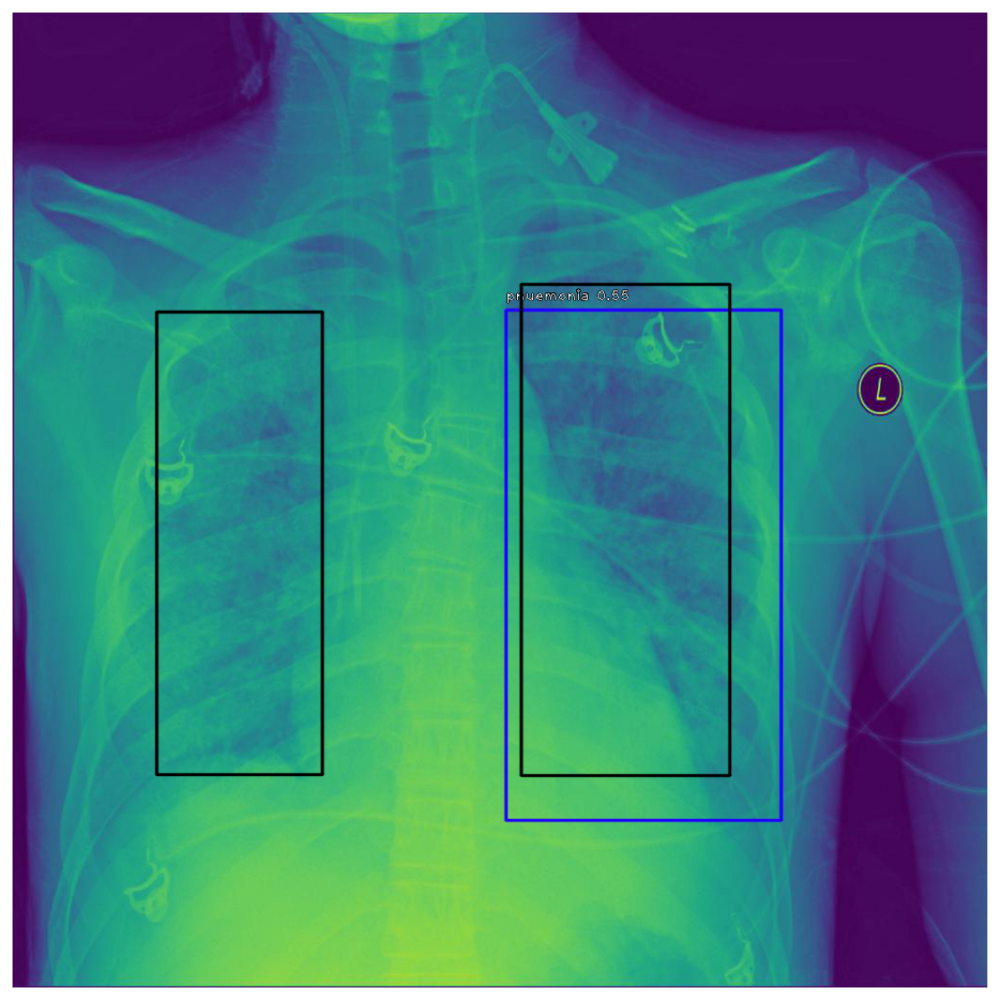

In [ ]:
THRES_SCORE = 0.4
patient_id='41b00808-a610-492c-b2f5-82de09d84366'
draw_image(patient_id)

•	RetinaNet Model Gives good Mean_Iou. There are no False Positives.

•	Even tough after 10 Epochs still loss is going to degrade. 

•	As per our mentor, We are looking to improve the model performance with increasing the number of Epochs and the learning rate. 

•	RetinaNet Model has considered to further development.


#Summary:
•	EDA has given the some meaningful insights about the data. There will be a huge class Imabalance. We are intent to balance the data with data augumentaion for the minority class & will generate 4 augmented images per minority class image.

•	RetinaNet Model gives the good results. So, we are intented to develop the model with tuning the hyperparameters in further. 
